# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [3]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [4]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [5]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [6]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [7]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [8]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = (torch.mean(gradient_norm-1)) ** 2 
    #### END CODE HERE ####
    return penalty

In [9]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = -torch.mean(crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

In [11]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [12]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = torch.mean(crit_fake_pred) - torch.mean(crit_real_pred) + c_lambda * gp
    #### END CODE HERE ####
    return crit_loss

In [13]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.007456624526530504, critic loss: 0.5956759799961001


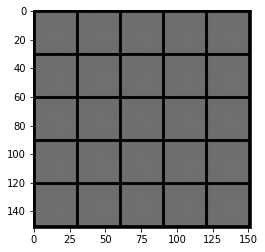

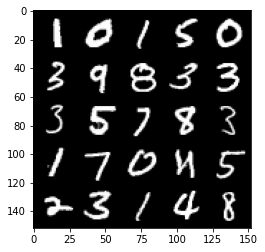

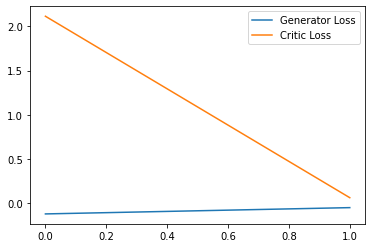

Step 100: Generator loss: 1.7046532490849495, critic loss: -3.52694394338131


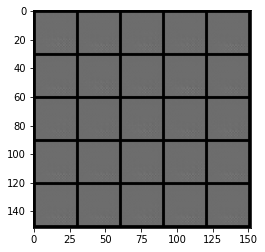

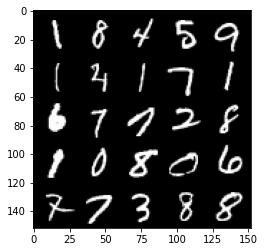

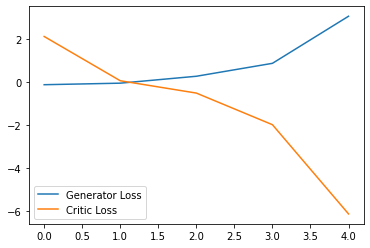

Step 150: Generator loss: 3.0849005293846132, critic loss: -14.561274467468262


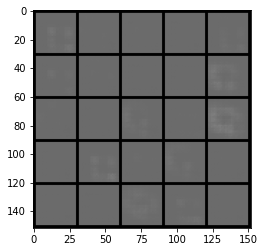

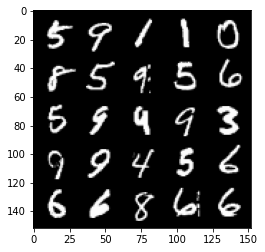

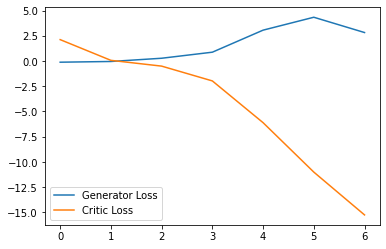

Step 200: Generator loss: -0.048477100133895876, critic loss: -32.44632683563233


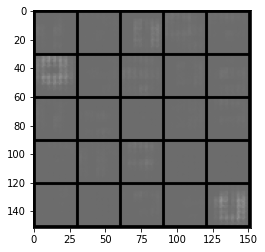

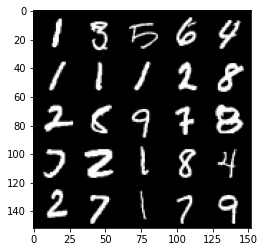

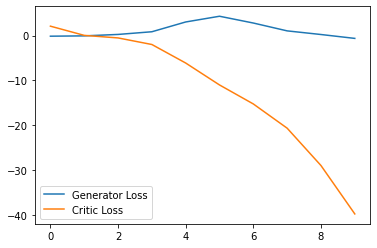

Step 250: Generator loss: -1.947042813897133, critic loss: -63.94982611083984


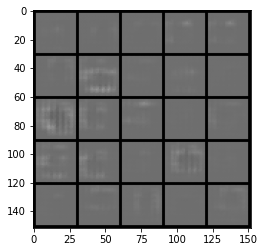

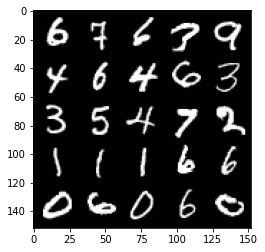

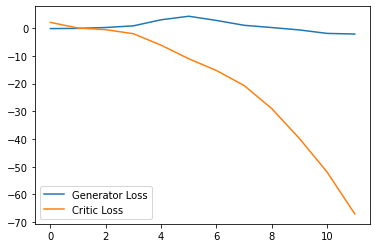

Step 300: Generator loss: -1.9409742474555969, critic loss: -108.93428149414062


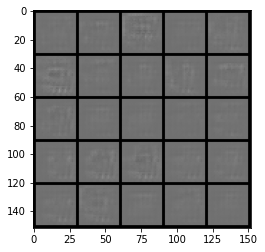

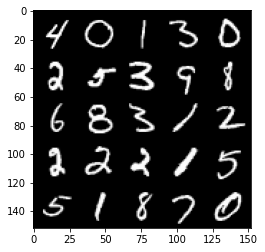

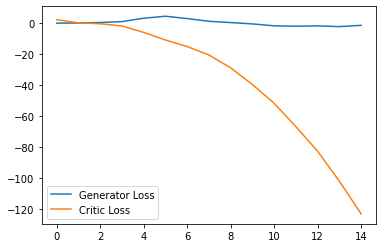

Step 350: Generator loss: 1.629971376657486, critic loss: -164.20496994018552


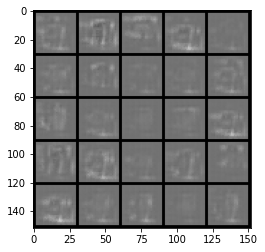

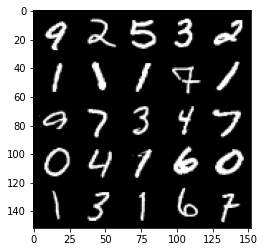

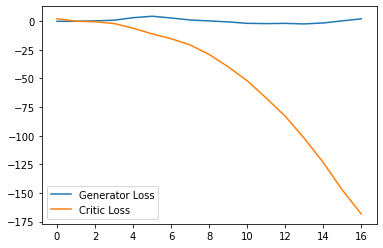

Step 400: Generator loss: 3.7194268465042115, critic loss: -223.77783129882823


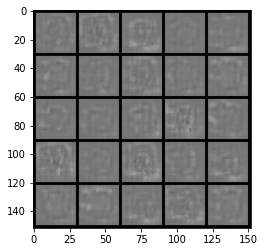

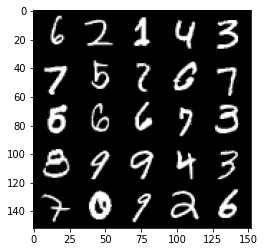

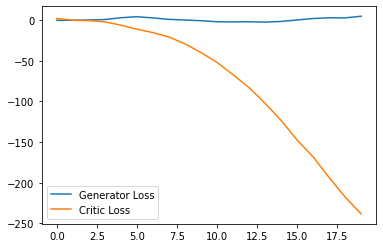

Step 450: Generator loss: 1.7614372247457504, critic loss: -256.9044178466797


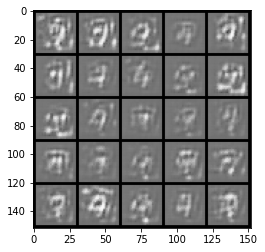

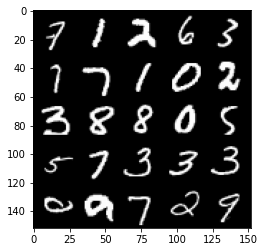

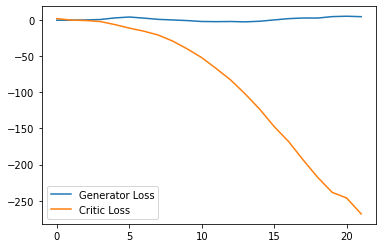

Step 500: Generator loss: -40.277338013648986, critic loss: -191.9919362182617


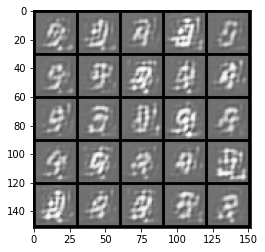

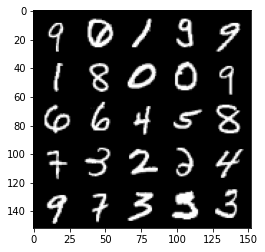

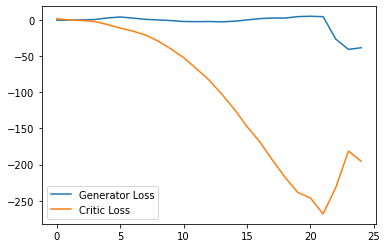

Step 550: Generator loss: 2.605170307159424, critic loss: -272.28750860595704


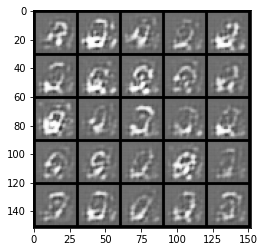

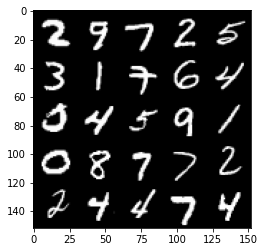

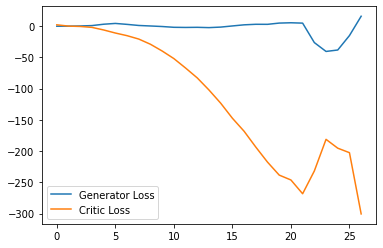

Step 600: Generator loss: 1.8468514081835747, critic loss: -378.65438546752927


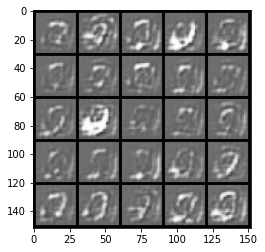

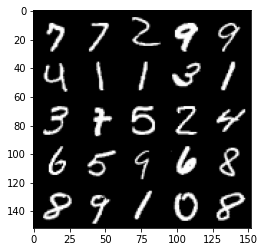

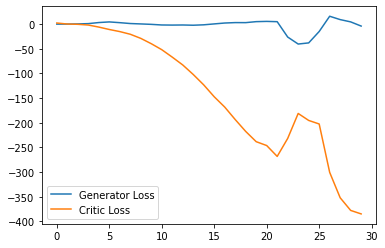

Step 650: Generator loss: -12.73121655702591, critic loss: -392.5573776855469


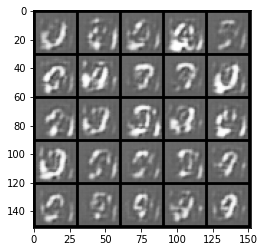

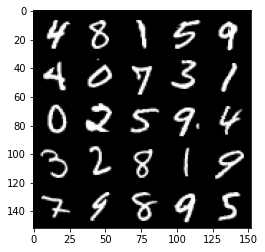

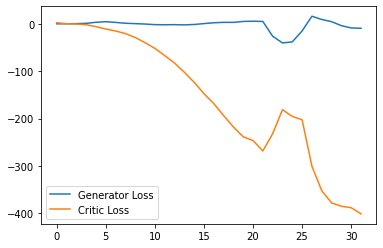

Step 700: Generator loss: -70.13286830902099, critic loss: -274.9983446350098


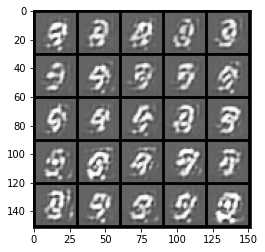

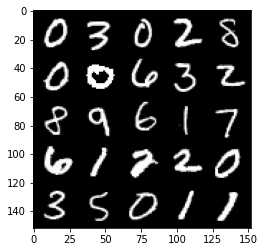

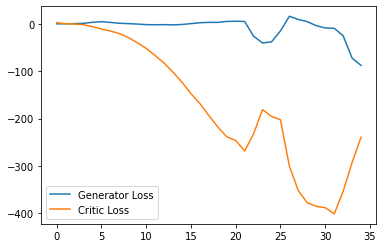

Step 750: Generator loss: -18.013765935897826, critic loss: -357.95735290527335


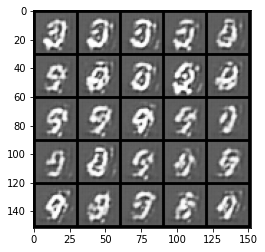

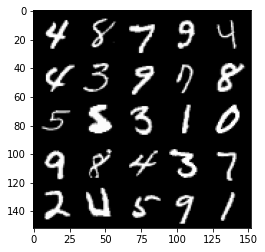

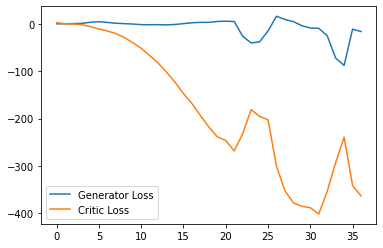

Step 800: Generator loss: -40.25258032858372, critic loss: -330.17856967163084


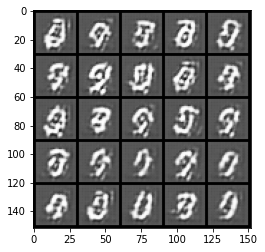

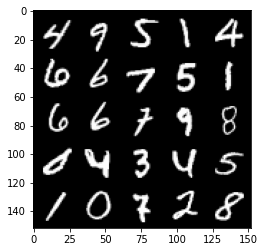

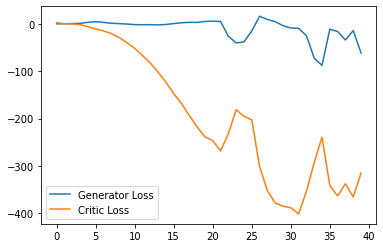

Step 850: Generator loss: -45.126207191944125, critic loss: -310.0660004882813


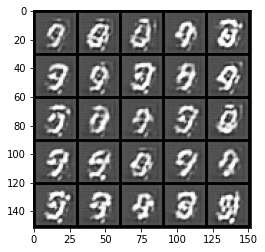

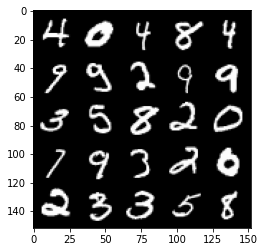

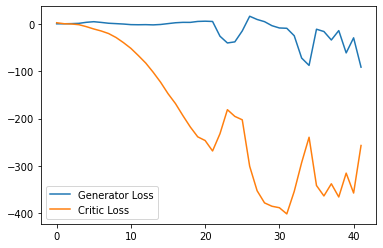

Step 900: Generator loss: -41.401947897672656, critic loss: -328.20077719116205


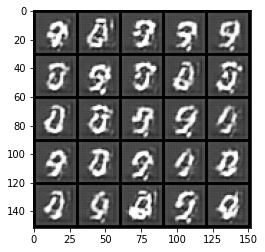

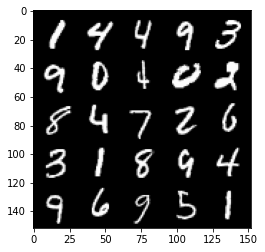

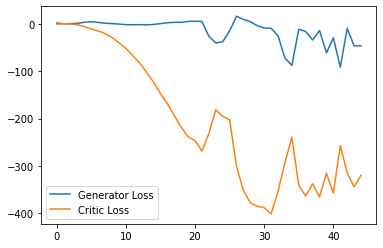

Step 950: Generator loss: -67.82368243217468, critic loss: -291.71316998291013


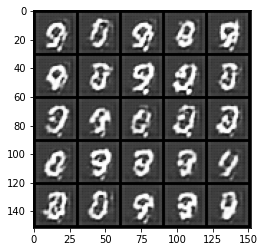

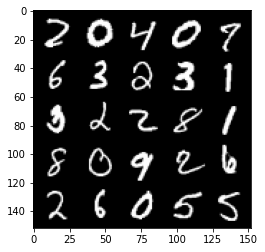

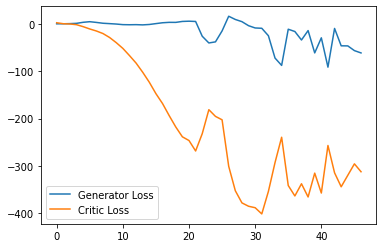

Step 1000: Generator loss: -53.90439717292786, critic loss: -157.05684332275393


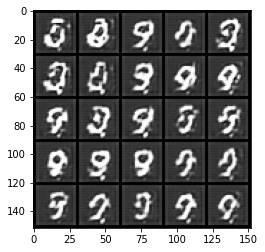

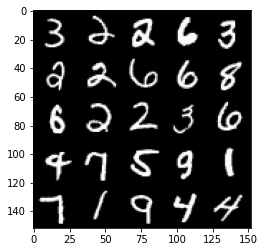

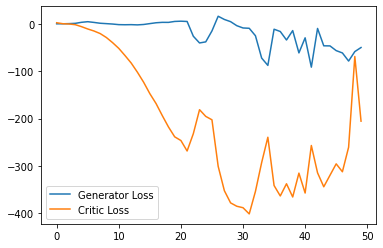

Step 1050: Generator loss: -55.10652099609375, critic loss: -60.48591298675537


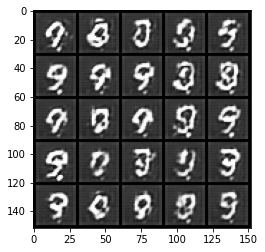

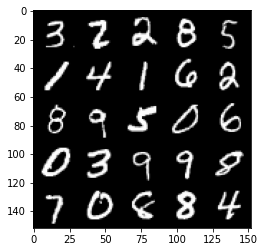

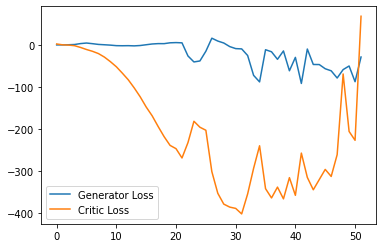

Step 1100: Generator loss: -53.72774101257324, critic loss: 13.449822921752933


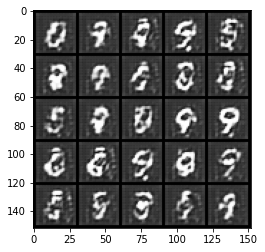

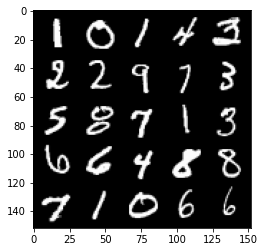

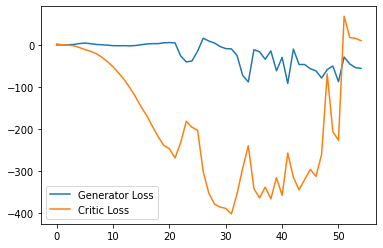

Step 1150: Generator loss: -57.950554046630856, critic loss: 5.2090482406616205


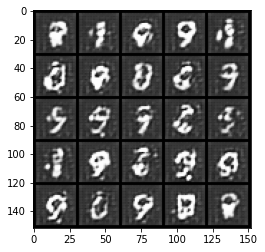

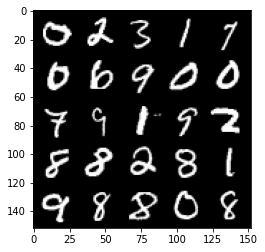

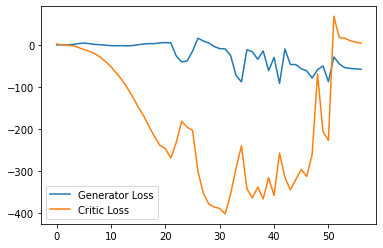

Step 1200: Generator loss: -62.164937286376954, critic loss: 2.0999205322265637


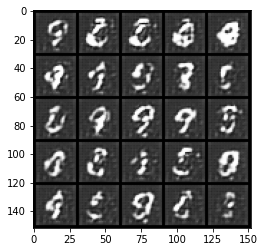

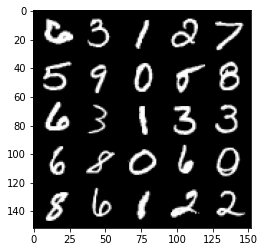

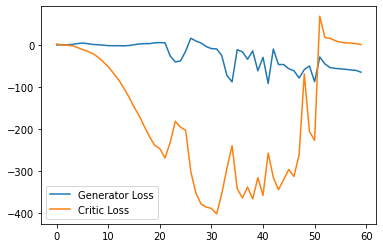

Step 1250: Generator loss: -73.02754814147949, critic loss: -55.11434695434571


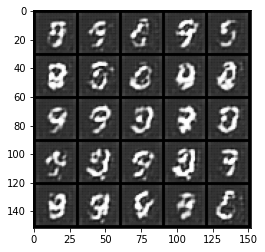

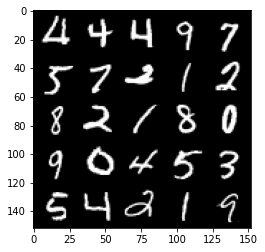

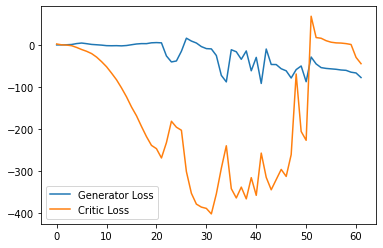

Step 1300: Generator loss: -85.9836183166504, critic loss: -58.56001403808597


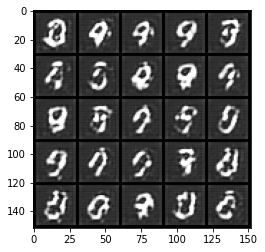

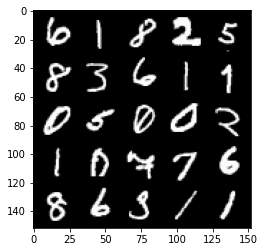

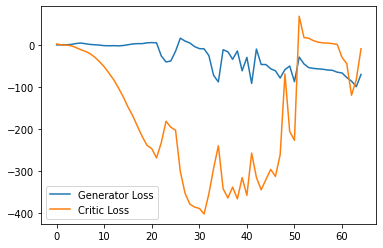

Step 1350: Generator loss: -47.42908191680908, critic loss: 4.398268203735352


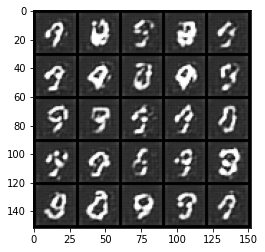

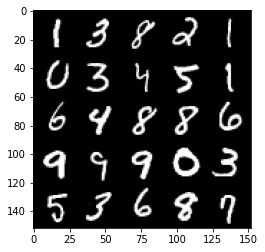

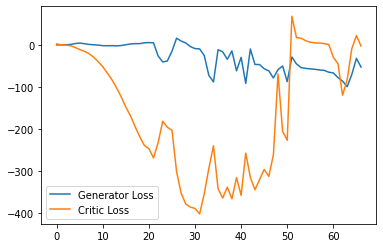

Step 1400: Generator loss: -81.4363520181179, critic loss: -43.14506907653809


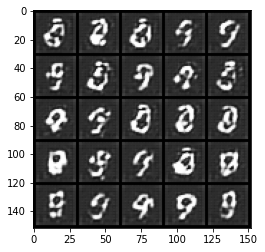

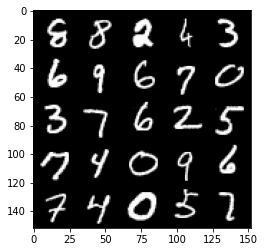

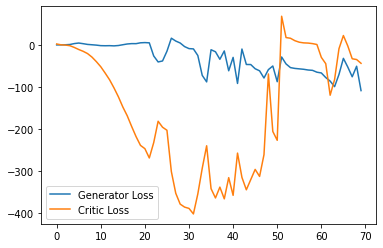

Step 1450: Generator loss: -77.33792419314385, critic loss: -14.927739654541021


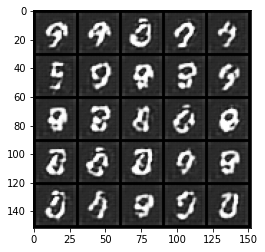

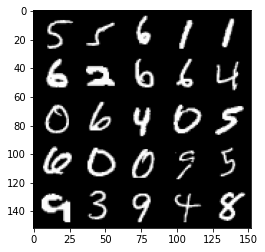

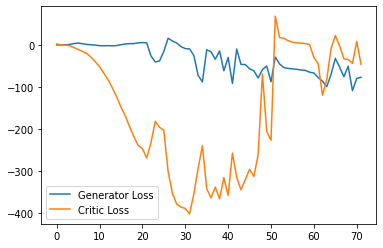

Step 1500: Generator loss: -65.88474515914918, critic loss: -2.7826822929382247


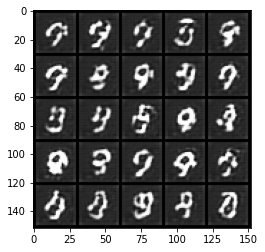

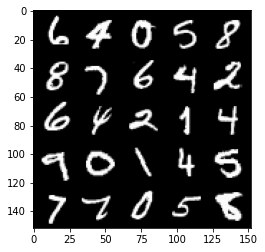

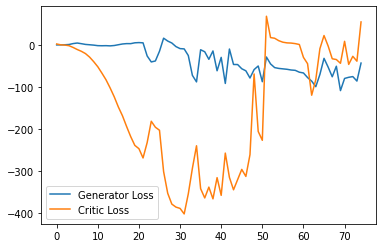

Step 1550: Generator loss: -30.428976135253905, critic loss: 15.36706421661377


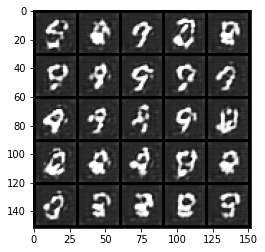

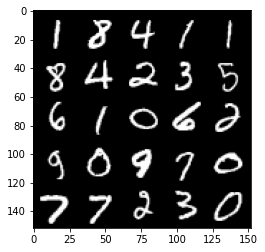

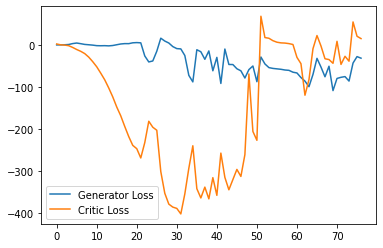

Step 1600: Generator loss: -51.494531860351564, critic loss: -0.7736557540893568


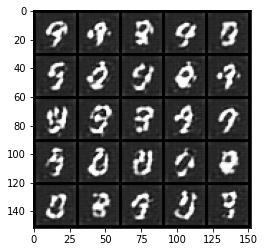

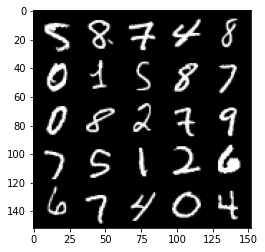

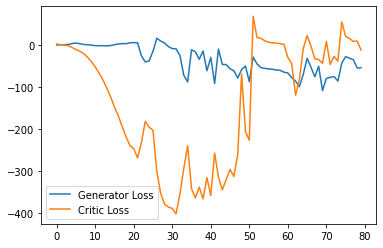

Step 1650: Generator loss: -55.600033874511716, critic loss: 1.0404747543334945


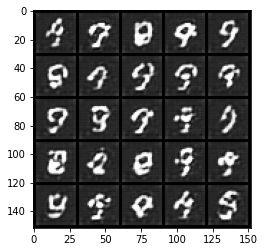

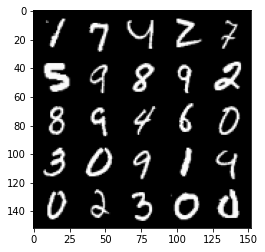

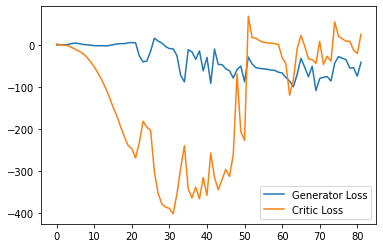

Step 1700: Generator loss: -46.03146711349487, critic loss: 7.626521987915042


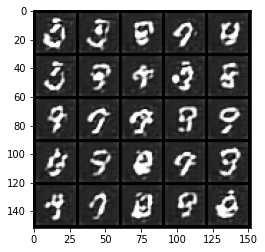

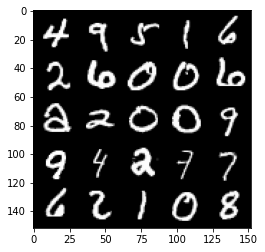

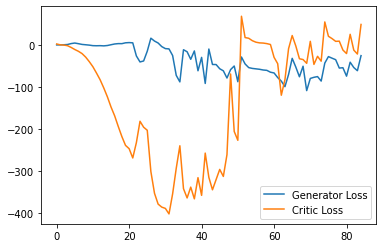

Step 1750: Generator loss: -58.8968928527832, critic loss: -11.575278533935546


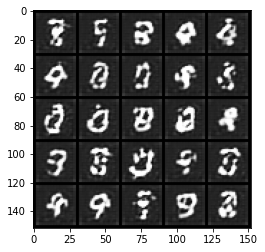

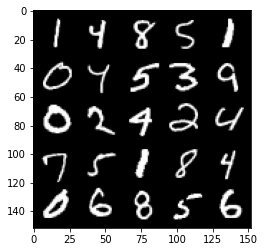

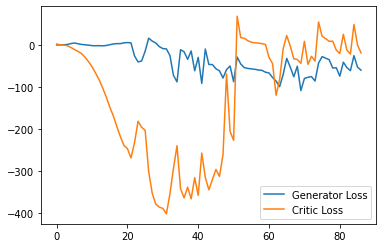

Step 1800: Generator loss: -59.43613265991211, critic loss: 13.665654373168945


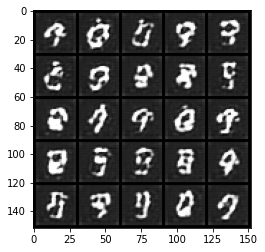

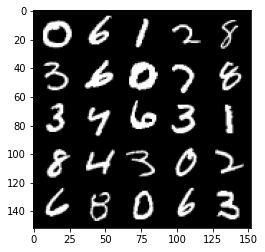

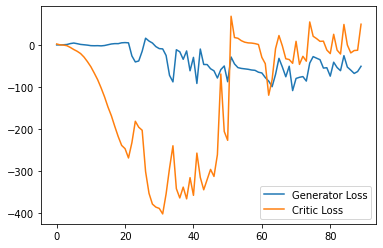

Step 1850: Generator loss: -39.260259780883786, critic loss: 34.22776161193848


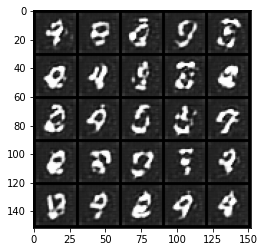

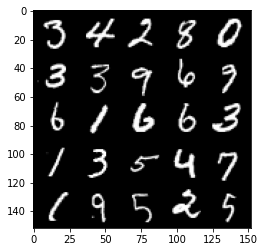

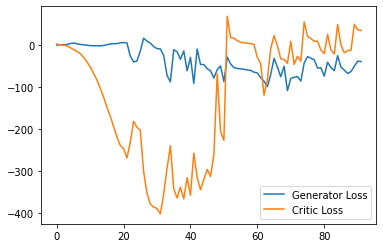

Step 1900: Generator loss: -39.171863327026365, critic loss: 25.5448257522583


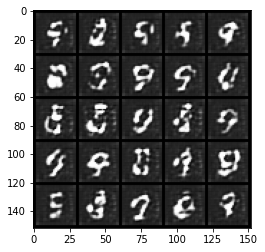

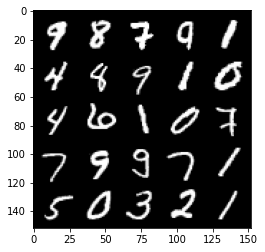

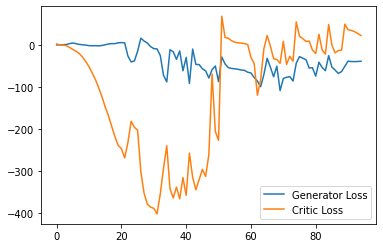

Step 1950: Generator loss: -37.54420265197754, critic loss: 14.303156764984132


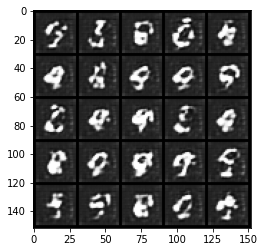

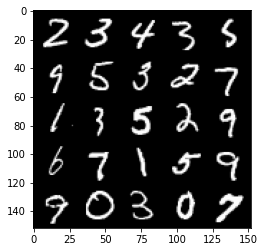

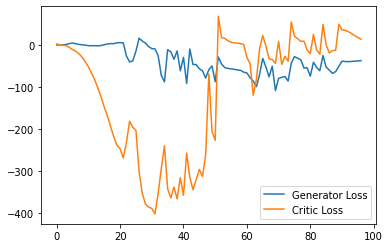

Step 2000: Generator loss: -36.60549301147461, critic loss: 6.748740459442139


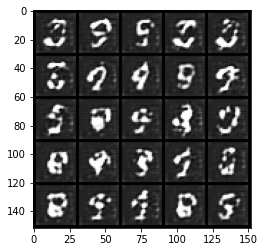

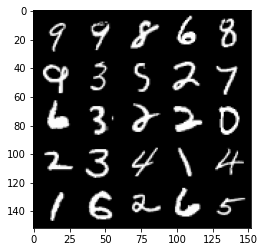

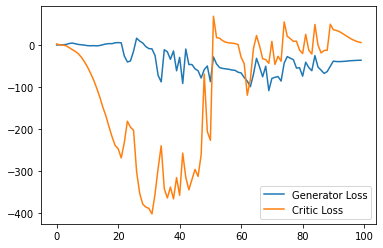

Step 2050: Generator loss: -36.7206649017334, critic loss: 3.8977679080963124


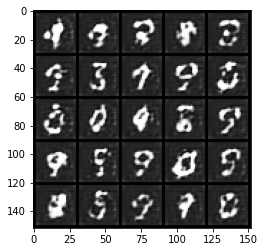

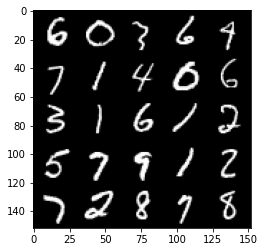

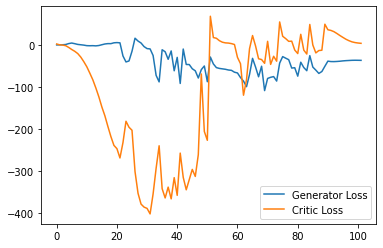

Step 2100: Generator loss: -36.8753540802002, critic loss: 3.060430690765382


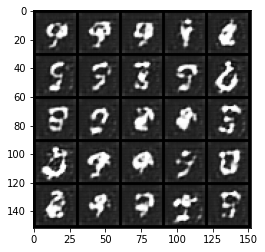

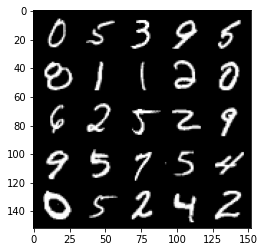

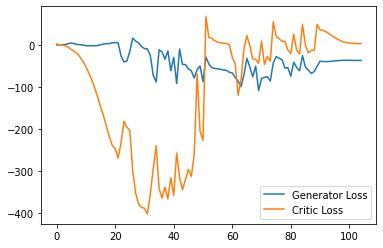

Step 2150: Generator loss: -36.48678909301758, critic loss: 3.045597826004028


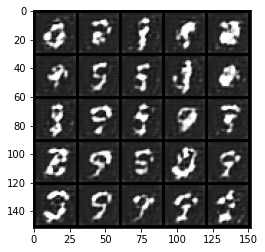

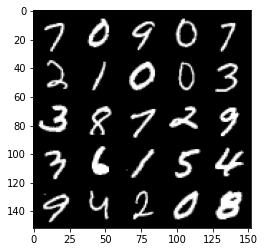

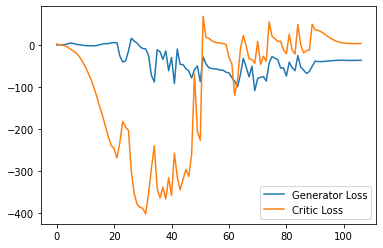

Step 2200: Generator loss: -35.77114067077637, critic loss: 2.4884957046508784


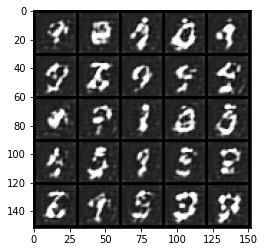

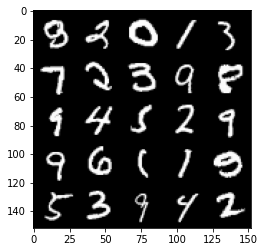

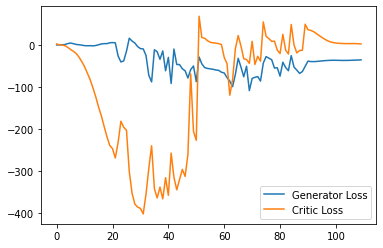

Step 2250: Generator loss: -35.16915321350098, critic loss: 1.6552034759521481


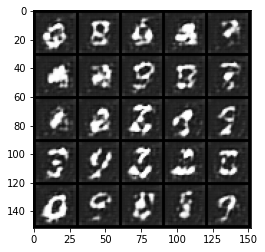

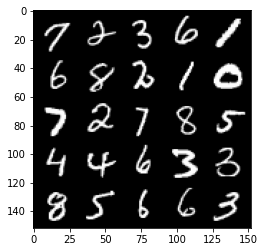

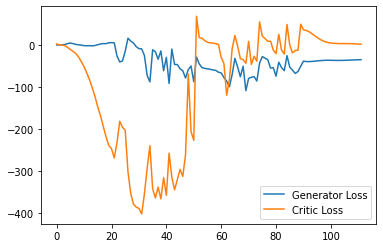

Step 2300: Generator loss: -35.166784057617186, critic loss: 0.8842301836013796


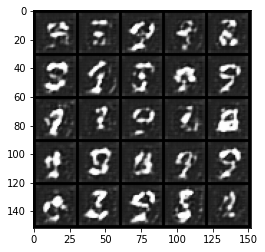

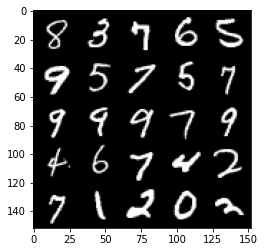

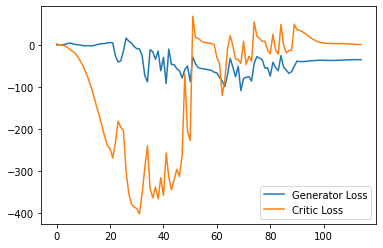

Step 2350: Generator loss: -36.146692428588864, critic loss: 0.14830266189575197


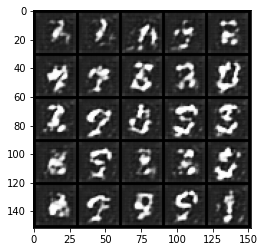

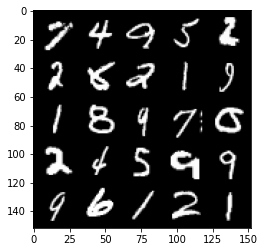

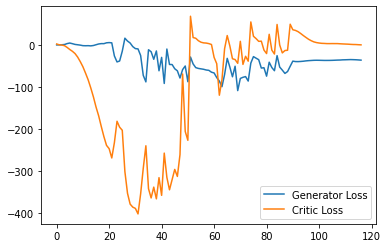

Step 2400: Generator loss: -37.604644012451175, critic loss: -0.6356696424484252


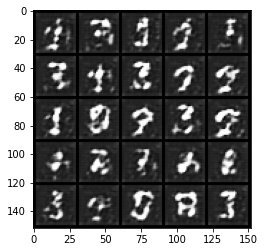

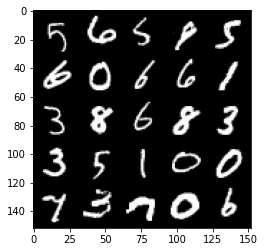

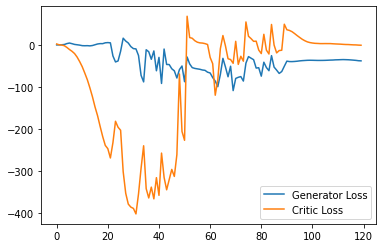

Step 2450: Generator loss: -38.1483194732666, critic loss: -1.7979132204055785


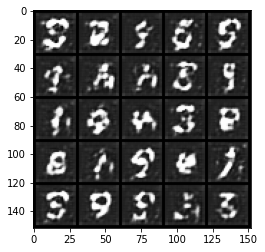

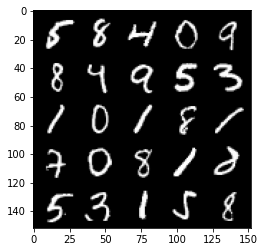

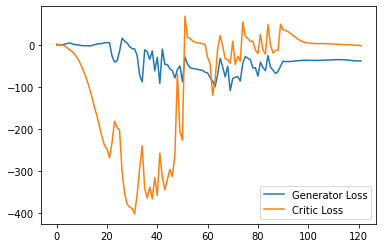

Step 2500: Generator loss: -38.960145492553714, critic loss: -3.945400858879089


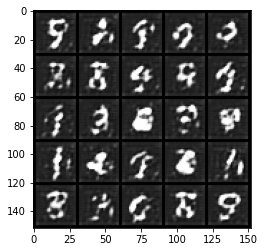

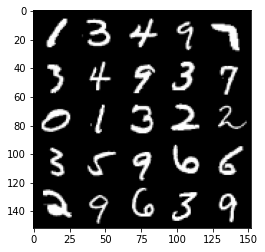

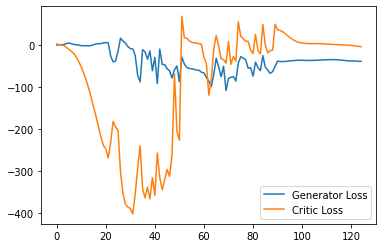

Step 2550: Generator loss: -38.8817788696289, critic loss: -7.249440813064574


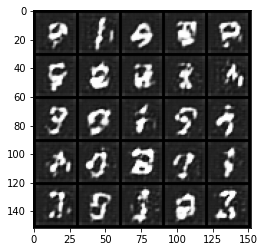

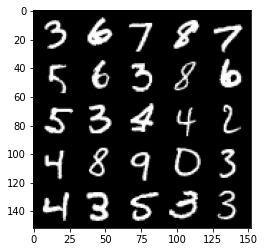

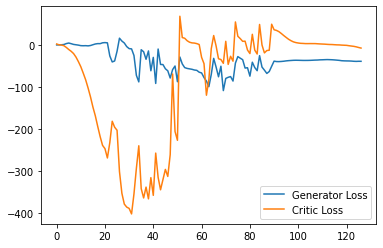

Step 2600: Generator loss: -37.1661531829834, critic loss: -9.008700983047483


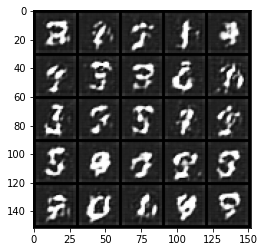

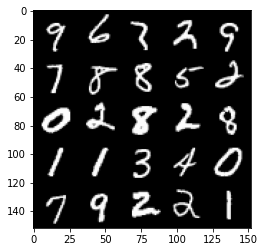

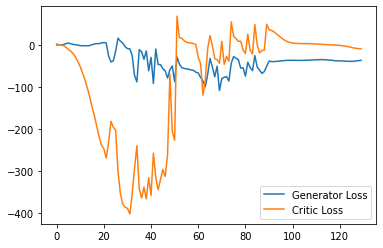

Step 2650: Generator loss: -36.30616973876953, critic loss: -9.434448616027833


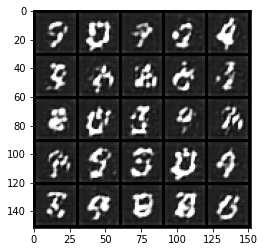

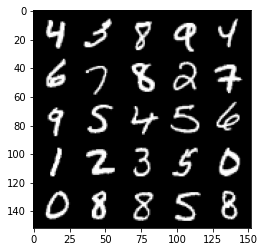

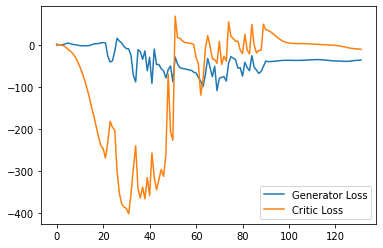

Step 2700: Generator loss: -35.26219707489014, critic loss: -11.296868196487424


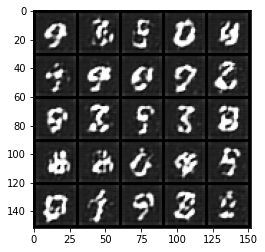

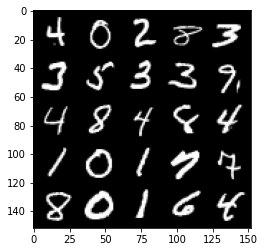

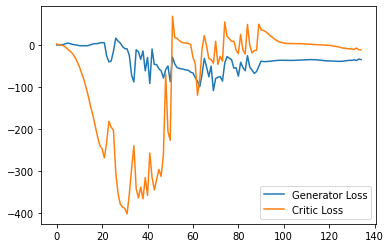

Step 2750: Generator loss: -32.34577751159668, critic loss: -11.881887802124021


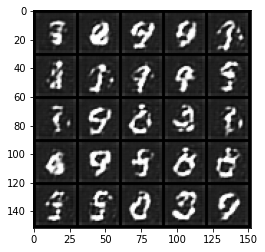

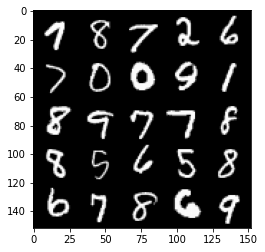

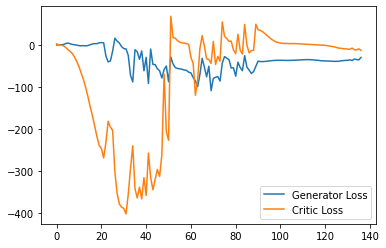

Step 2800: Generator loss: -30.018600692749022, critic loss: -14.19603069114685


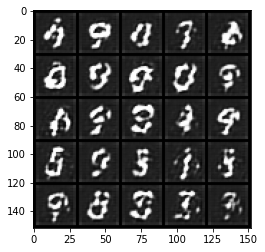

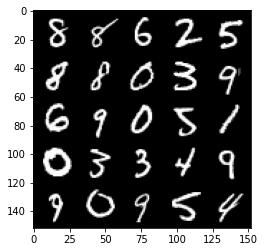

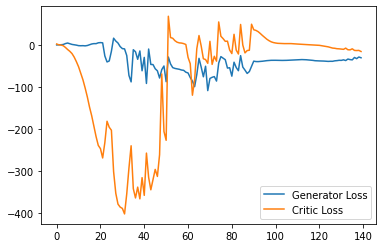

Step 2850: Generator loss: -27.525625247955322, critic loss: -14.143827720642092


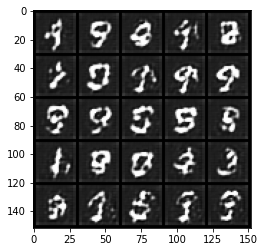

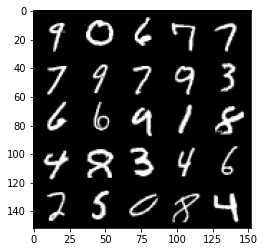

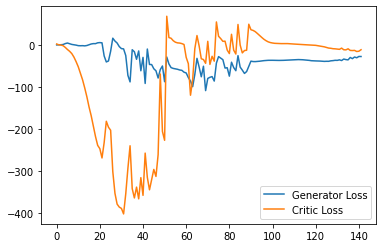

Step 2900: Generator loss: -25.814768543243407, critic loss: -15.572097909927368


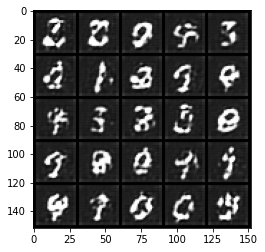

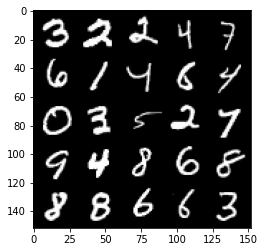

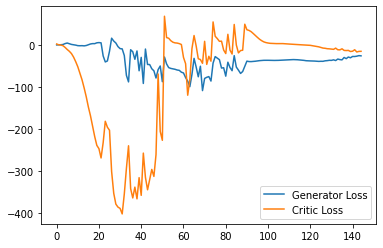

Step 2950: Generator loss: -26.252142419815062, critic loss: -16.05347401237488


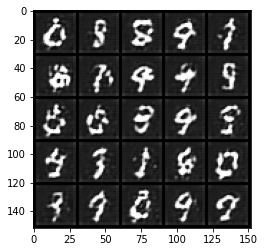

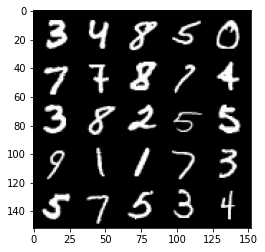

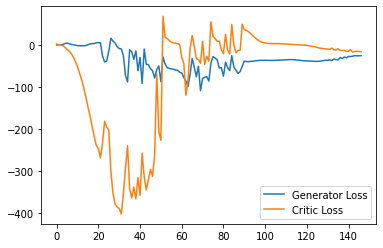

Step 3000: Generator loss: -23.742752466201782, critic loss: -18.49495733261108


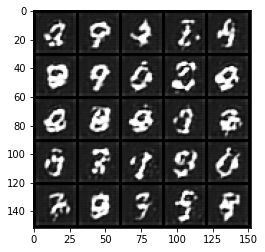

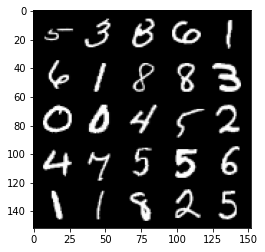

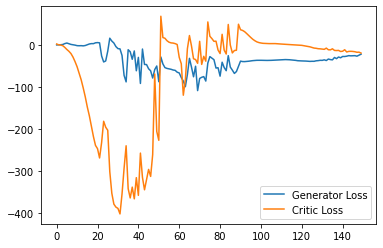

Step 3050: Generator loss: -23.731228199005127, critic loss: -13.76711601638794


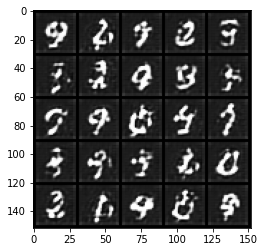

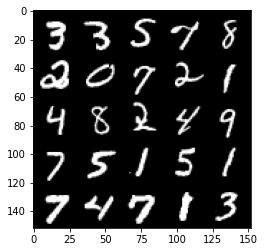

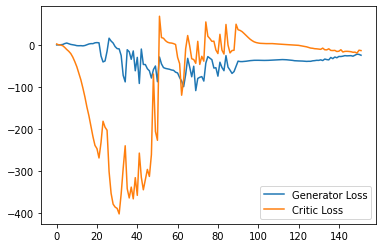

Step 3100: Generator loss: -22.96854872703552, critic loss: -18.293471435546877


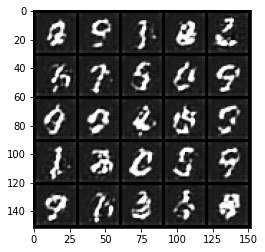

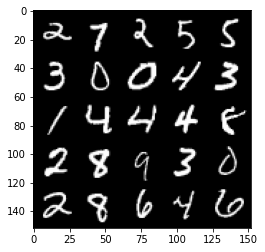

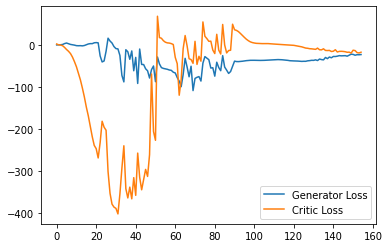

Step 3150: Generator loss: -24.84198139190674, critic loss: -17.882513017654418


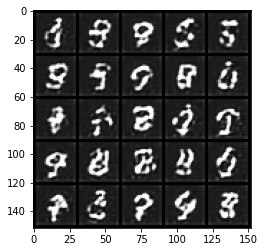

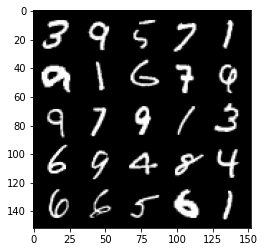

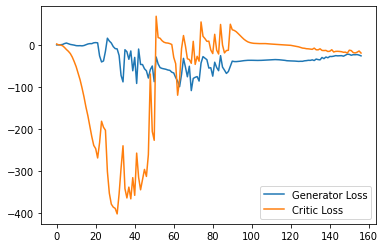

Step 3200: Generator loss: -20.980056653022768, critic loss: -14.874886835098259


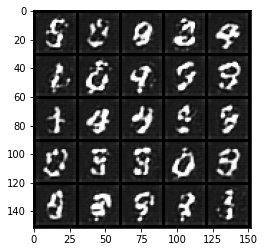

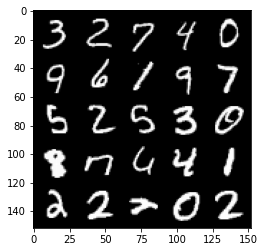

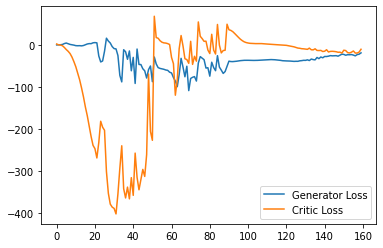

Step 3250: Generator loss: -21.564903202056886, critic loss: -19.52764656257629


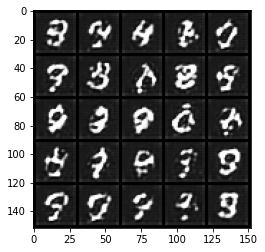

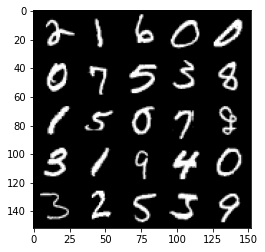

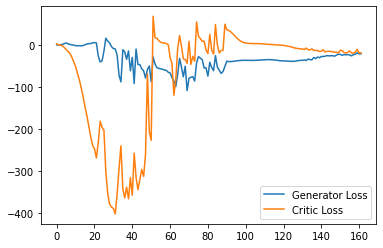

Step 3300: Generator loss: -20.06931396484375, critic loss: -18.04755089378357


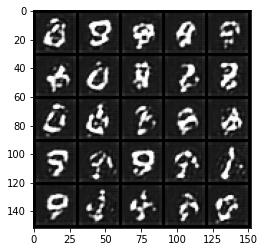

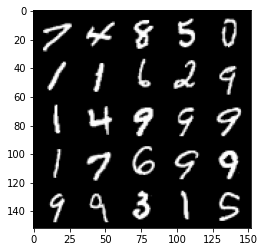

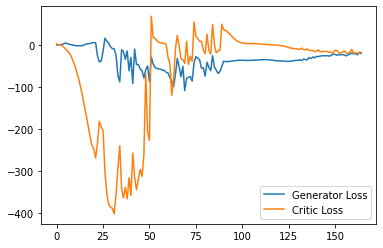

Step 3350: Generator loss: -19.778832778930663, critic loss: -19.13315412902832


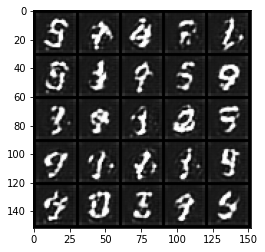

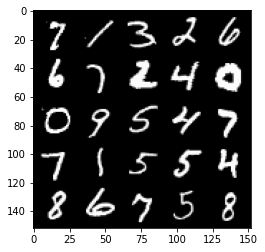

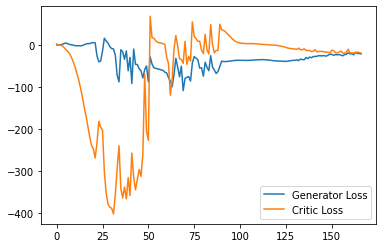

Step 3400: Generator loss: -18.4540305519104, critic loss: -15.555929809570312


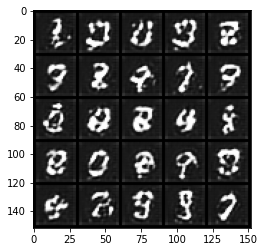

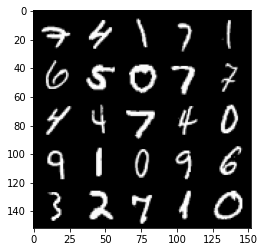

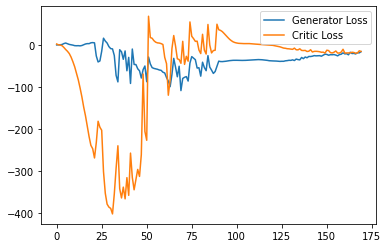

Step 3450: Generator loss: -20.54034086227417, critic loss: -21.979059930801398


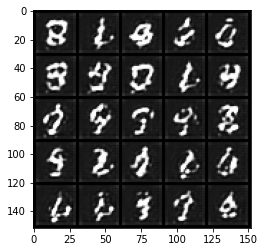

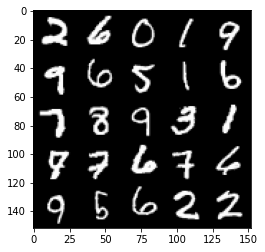

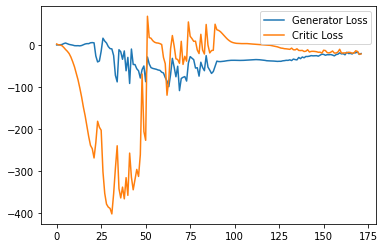

Step 3500: Generator loss: -19.57317711353302, critic loss: -20.32365419387817


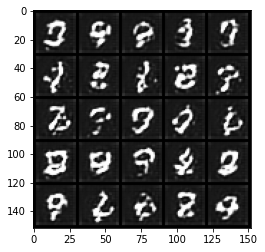

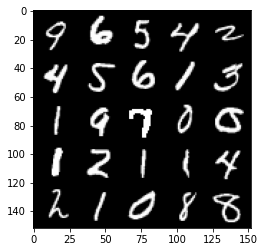

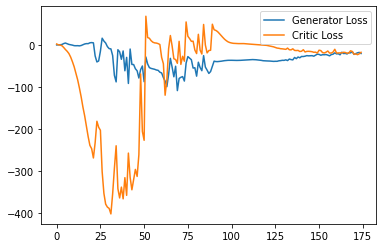

Step 3550: Generator loss: -20.585762166976927, critic loss: -19.674379220962525


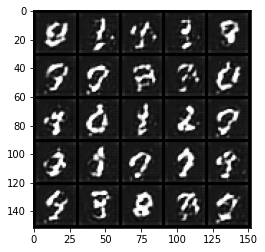

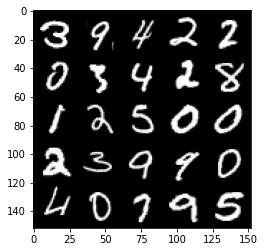

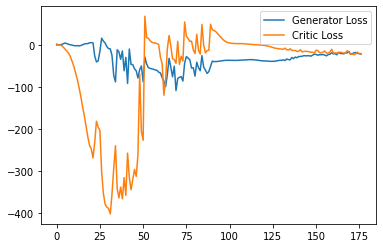

Step 3600: Generator loss: -22.11084924697876, critic loss: -15.994787171363825


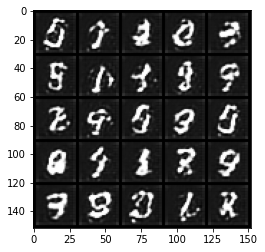

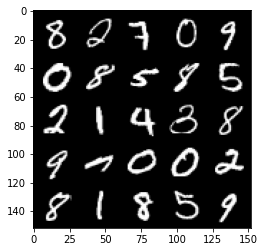

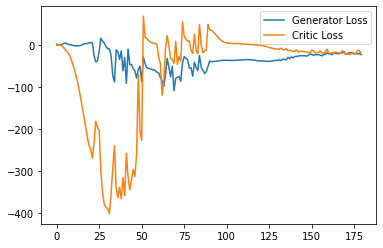

Step 3650: Generator loss: -22.121448402404784, critic loss: -20.17825196743011


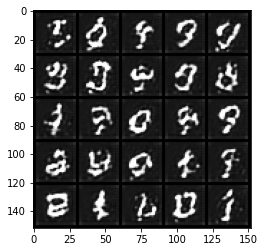

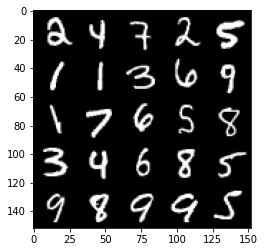

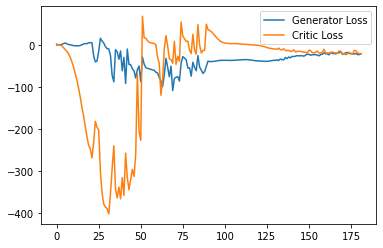

Step 3700: Generator loss: -21.356255331039428, critic loss: -17.050907592773438


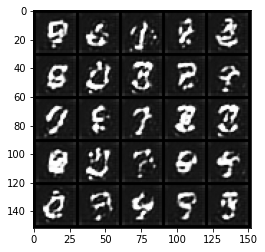

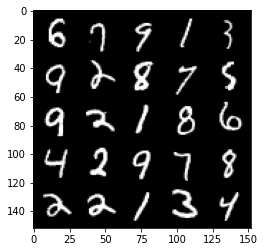

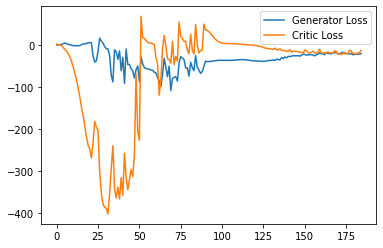

Step 3750: Generator loss: -21.797640590667726, critic loss: -17.729037645339968


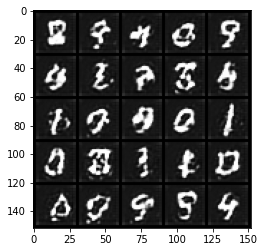

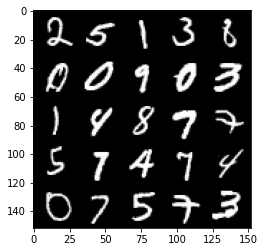

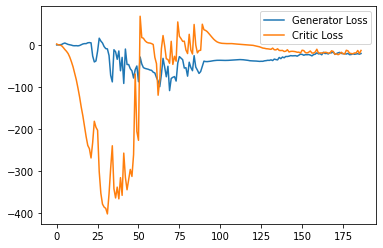

Step 3800: Generator loss: -21.05547924041748, critic loss: -15.958029228210442


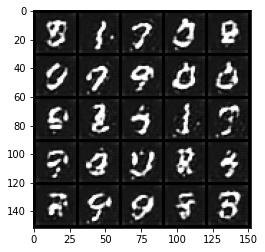

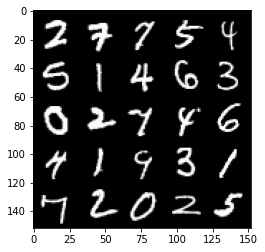

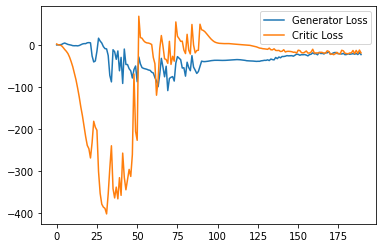

Step 3850: Generator loss: -22.448491744995117, critic loss: -22.07712452411652


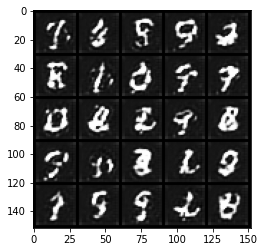

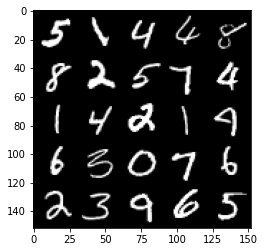

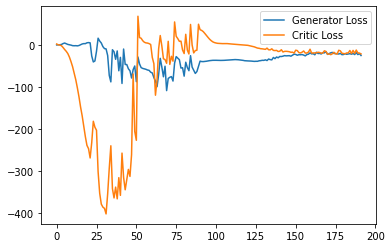

Step 3900: Generator loss: -19.211629381179808, critic loss: -13.719312864780429


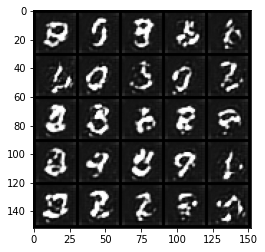

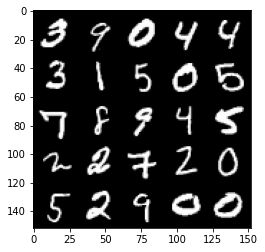

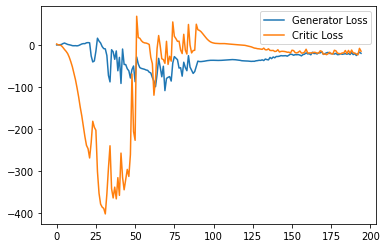

Step 3950: Generator loss: -26.074791717529298, critic loss: -20.554929349422455


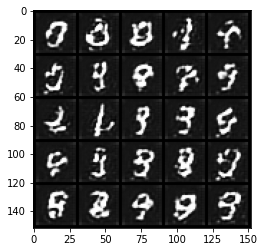

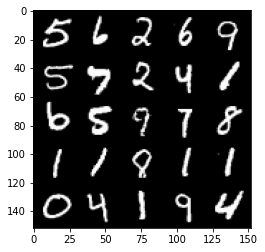

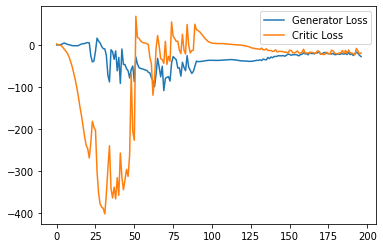

Step 4000: Generator loss: -19.22184862136841, critic loss: -8.744954566001892


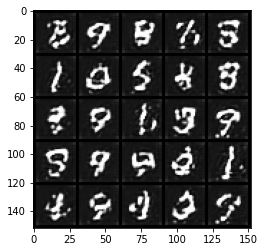

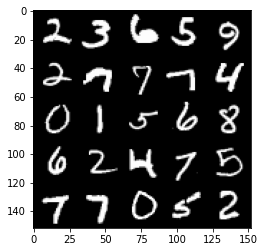

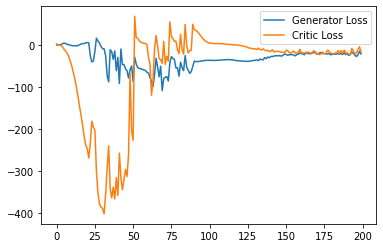

Step 4050: Generator loss: -24.961955108642577, critic loss: -20.21333029651642


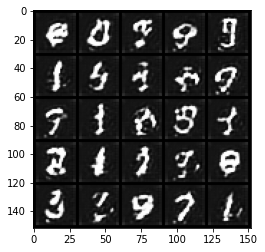

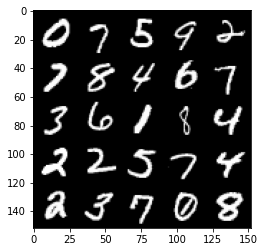

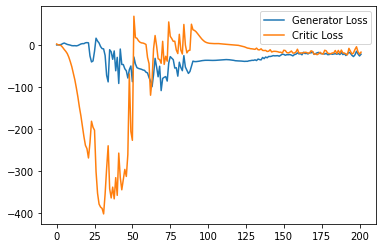

Step 4100: Generator loss: -21.98389447212219, critic loss: -12.847988885879518


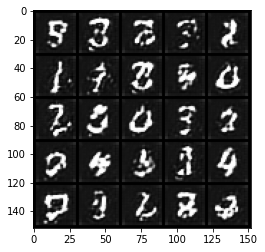

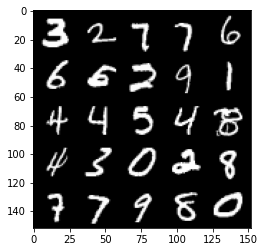

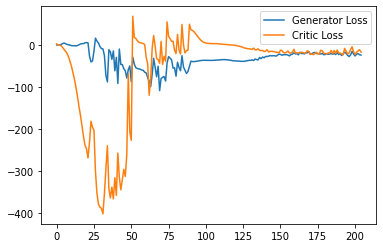

Step 4150: Generator loss: -24.881704959869385, critic loss: -20.105012455224987


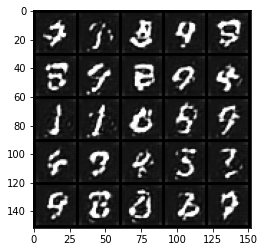

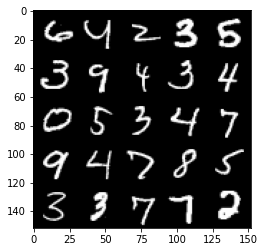

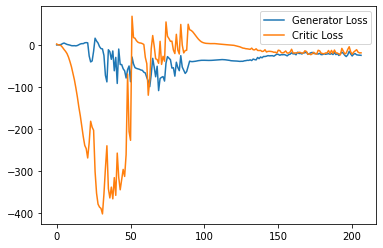

Step 4200: Generator loss: -20.069657011032106, critic loss: -14.448179529190066


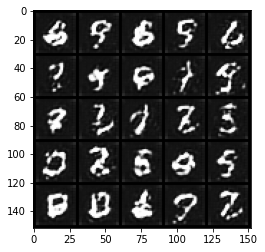

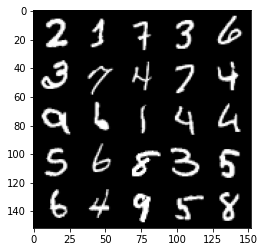

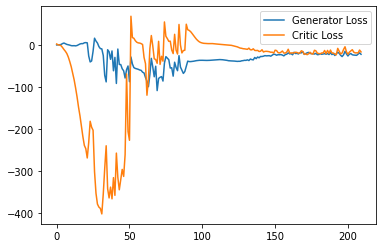

Step 4250: Generator loss: -24.195889797210693, critic loss: -16.084692080974573


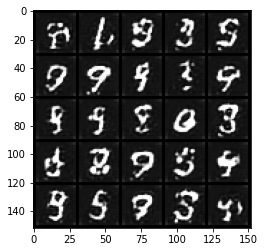

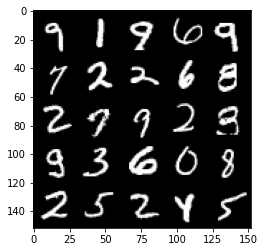

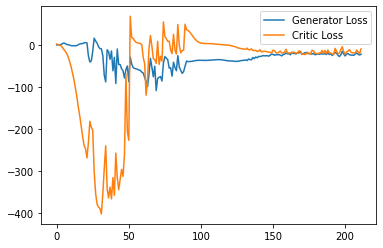

Step 4300: Generator loss: -24.4597550201416, critic loss: -19.891111092090608


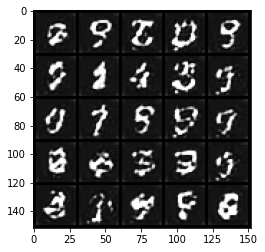

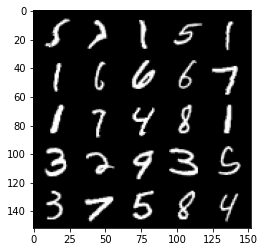

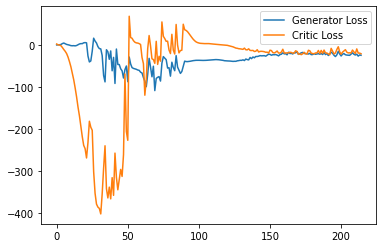

Step 4350: Generator loss: -20.290042066574095, critic loss: -15.061618017673492


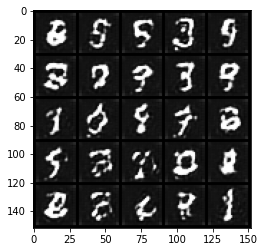

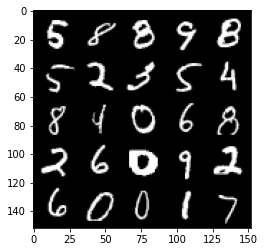

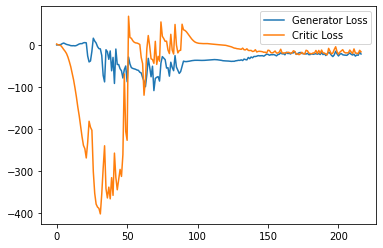

Step 4400: Generator loss: -26.39909996032715, critic loss: -20.40008613300323


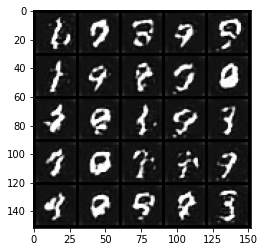

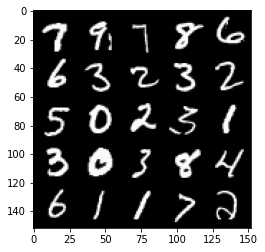

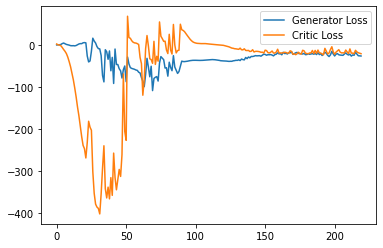

Step 4450: Generator loss: -17.80777105331421, critic loss: -7.143391586303711


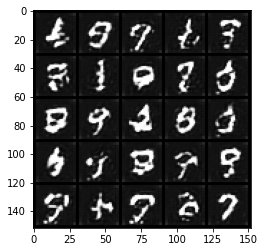

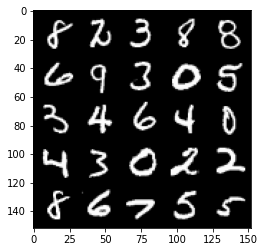

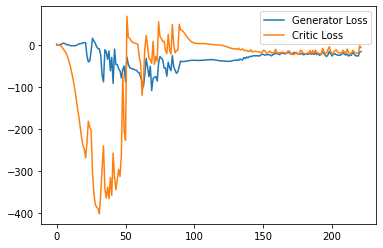

Step 4500: Generator loss: -21.8612003326416, critic loss: -17.13057126522064


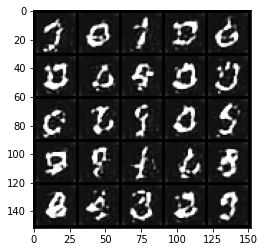

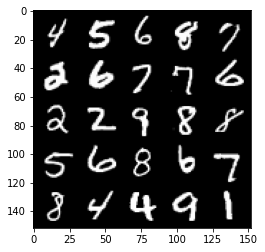

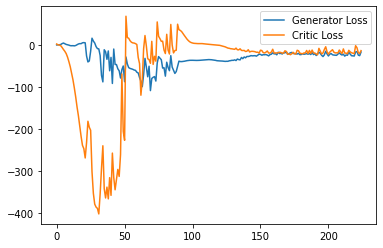

Step 4550: Generator loss: -24.006484069824218, critic loss: -19.322307638645174


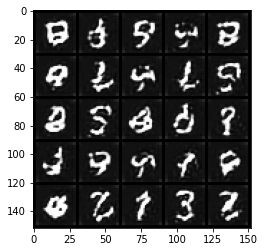

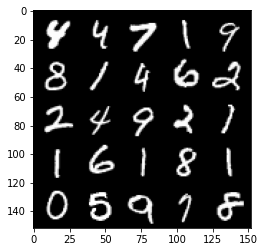

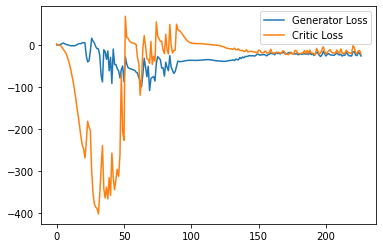

Step 4600: Generator loss: -17.64280233383179, critic loss: -4.141361944198607


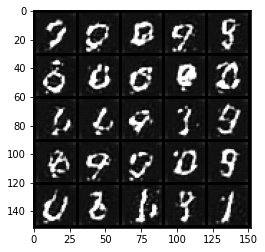

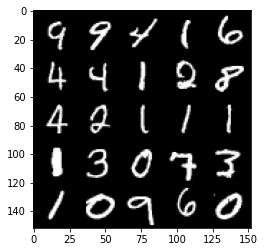

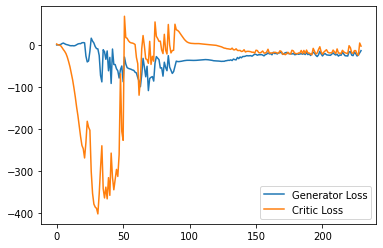

Step 4650: Generator loss: -15.9334157371521, critic loss: -3.247152099609375


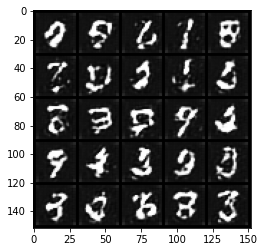

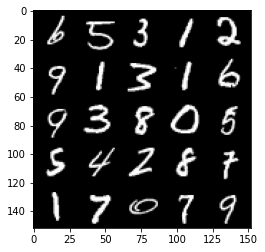

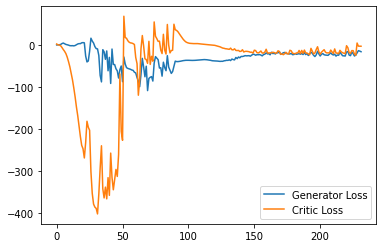

Step 4700: Generator loss: -18.92361671447754, critic loss: -3.889314214706421


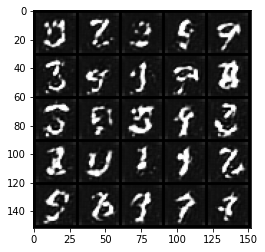

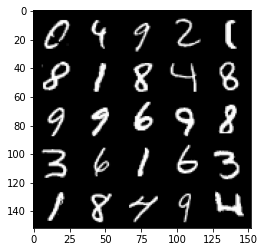

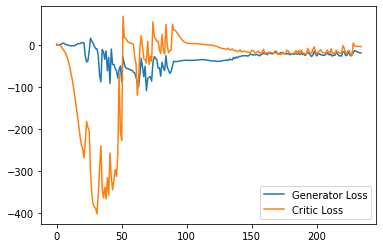

Step 4750: Generator loss: -23.577592658996583, critic loss: -9.619465157508849


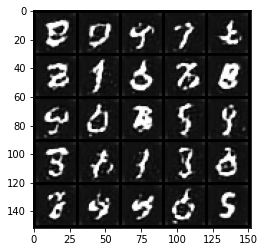

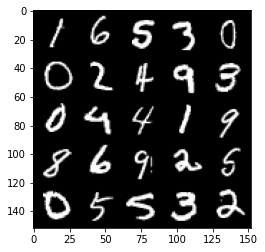

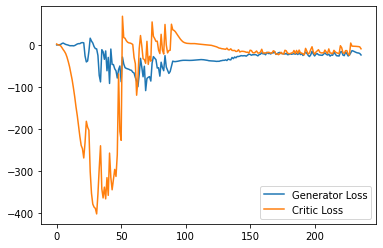

Step 4800: Generator loss: -24.355552225112916, critic loss: -15.496951357364653


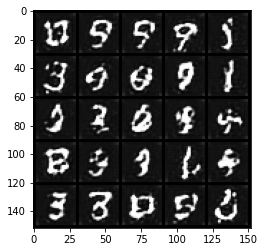

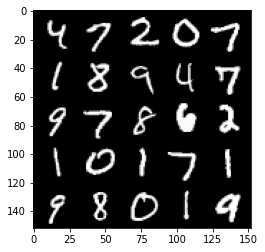

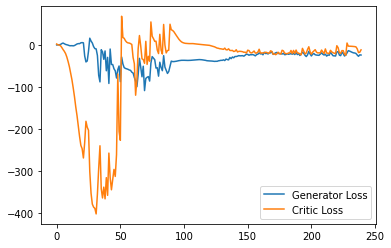

Step 4850: Generator loss: -21.80168264269829, critic loss: -16.811393456935882


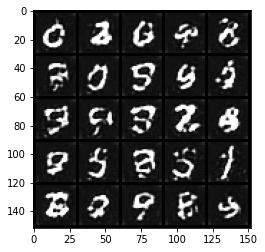

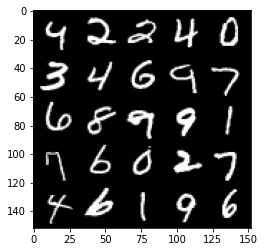

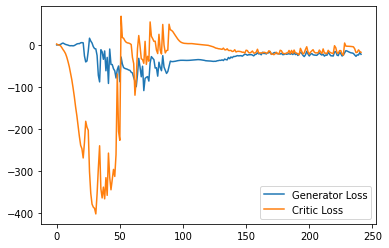

Step 4900: Generator loss: -23.45994821548462, critic loss: -20.243180694580083


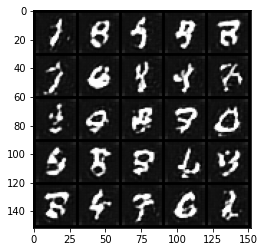

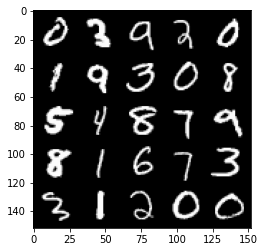

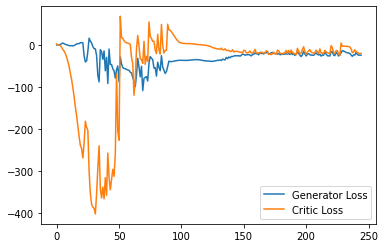

Step 4950: Generator loss: -21.598591885566712, critic loss: -20.509867041587828


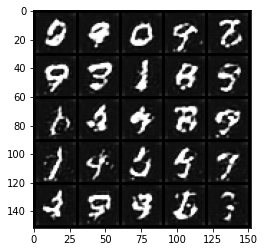

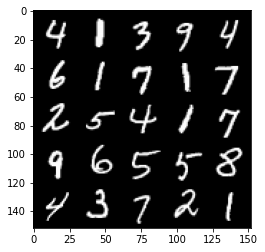

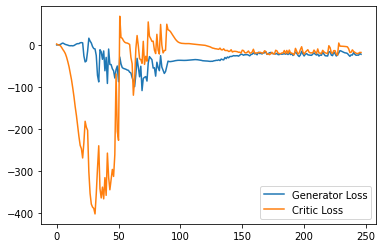

Step 5000: Generator loss: -20.282251105308532, critic loss: -18.834444402217876


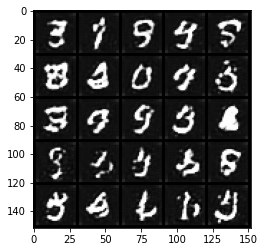

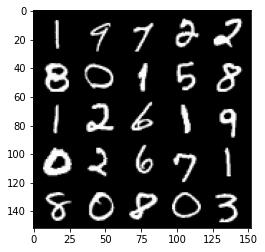

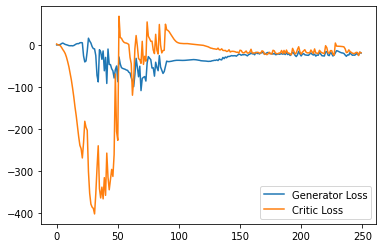

Step 5050: Generator loss: -14.57278959274292, critic loss: -4.923255758762359


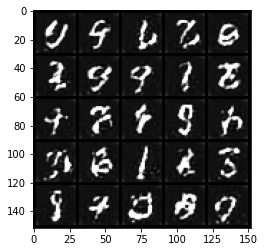

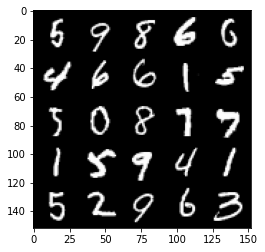

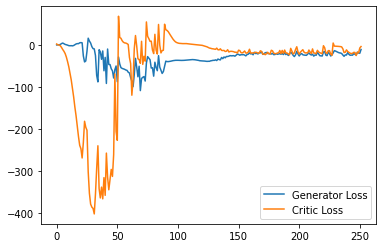

Step 5100: Generator loss: -22.246450309753417, critic loss: -16.0489177942276


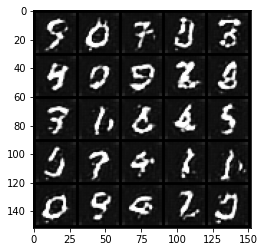

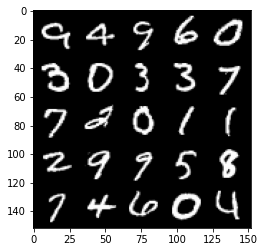

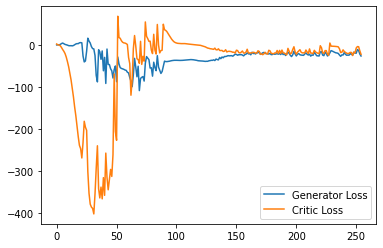

Step 5150: Generator loss: -11.861559896469116, critic loss: -1.2109576683044432


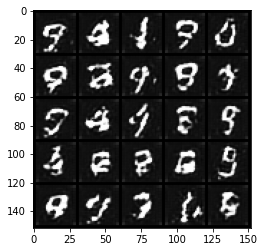

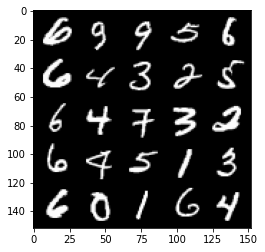

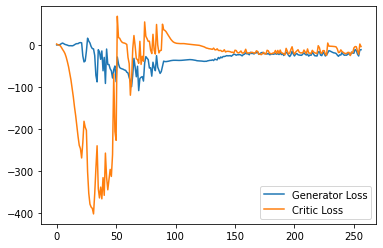

Step 5200: Generator loss: -17.901738719940184, critic loss: -9.475623434066772


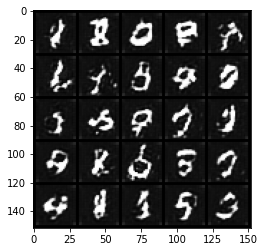

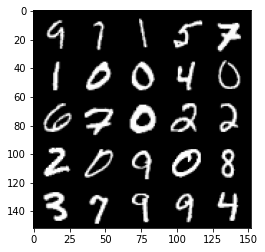

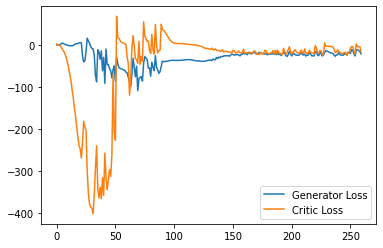

Step 5250: Generator loss: -23.172472195625303, critic loss: -11.72673795986176


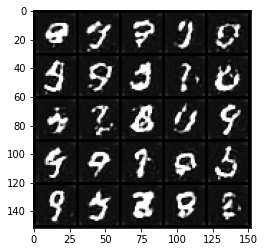

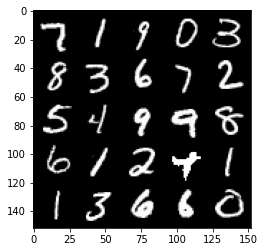

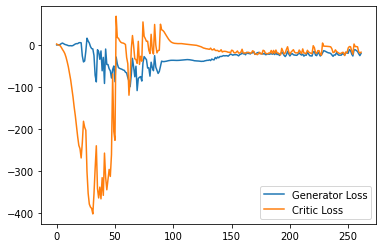

Step 5300: Generator loss: -22.467197742462158, critic loss: -16.14330870628357


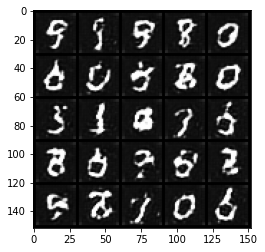

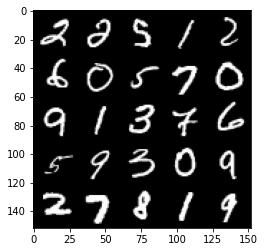

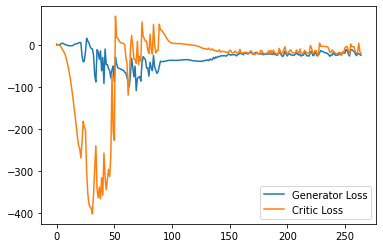

Step 5350: Generator loss: -21.538774369359018, critic loss: -20.494433014869692


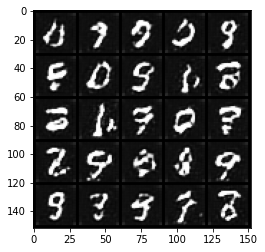

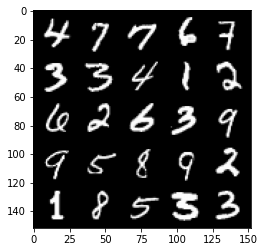

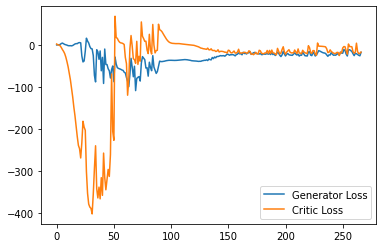

Step 5400: Generator loss: -23.689384565353393, critic loss: -21.46793752717972


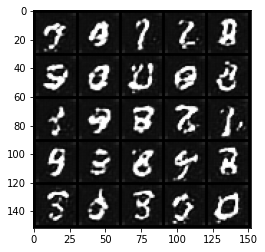

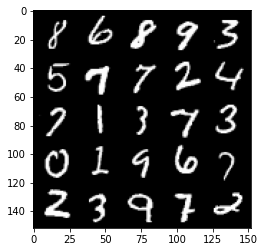

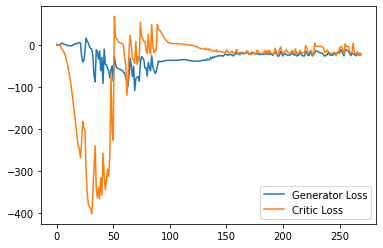

Step 5450: Generator loss: -18.983834562301634, critic loss: -18.83983151674271


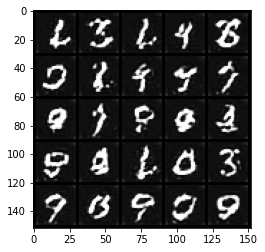

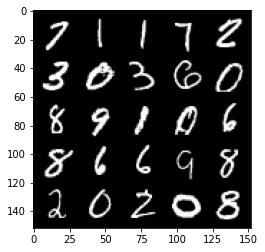

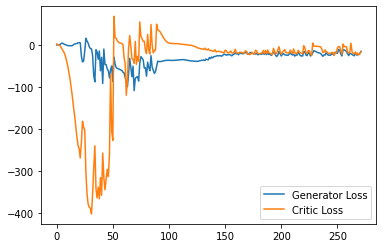

Step 5500: Generator loss: -16.094029238224028, critic loss: -12.309684208631513


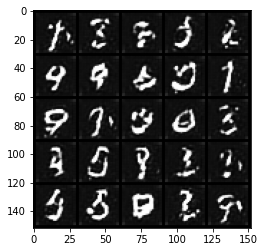

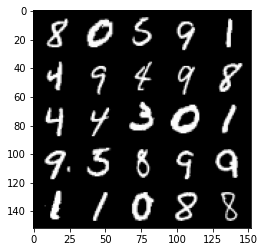

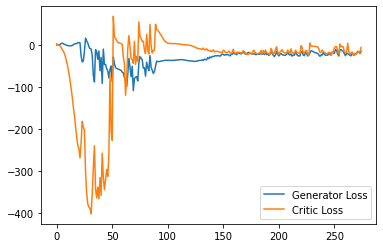

Step 5550: Generator loss: -16.01527225494385, critic loss: -10.426661566257478


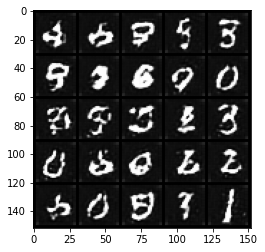

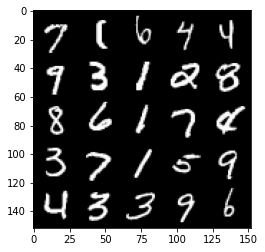

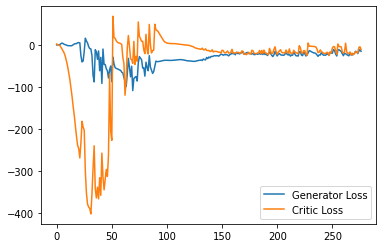

Step 5600: Generator loss: -18.243001844882965, critic loss: -7.906140979766848


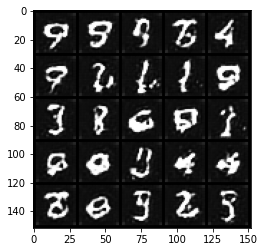

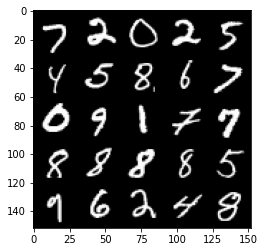

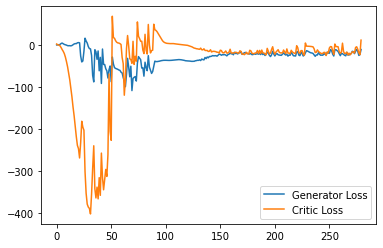

Step 5650: Generator loss: -14.430209293365479, critic loss: -3.8878233242034916


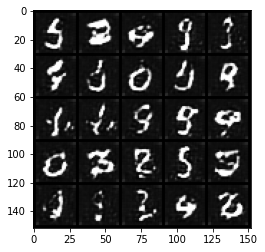

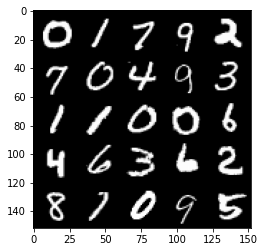

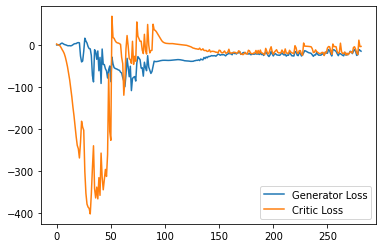

Step 5700: Generator loss: -17.084625511169435, critic loss: -5.8157056827545155


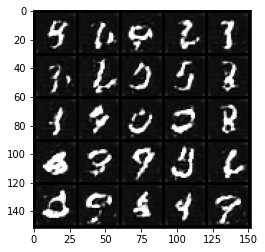

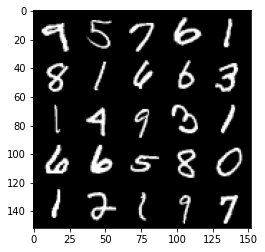

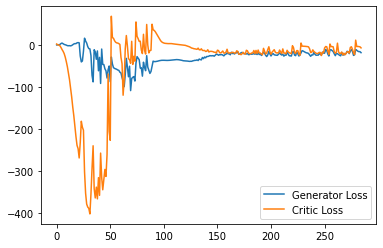

Step 5750: Generator loss: -25.070544128417968, critic loss: -19.08142301654815


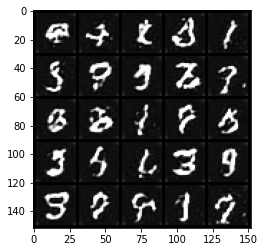

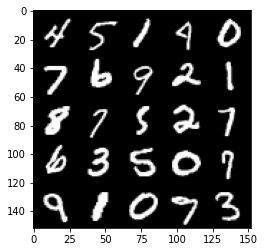

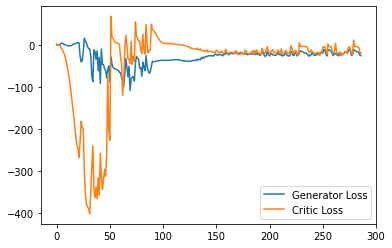

Step 5800: Generator loss: -18.88991892814636, critic loss: -22.161543620109555


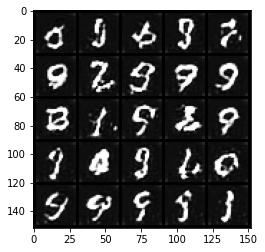

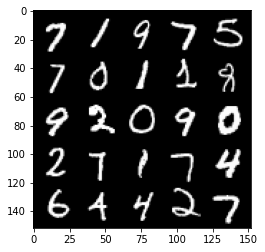

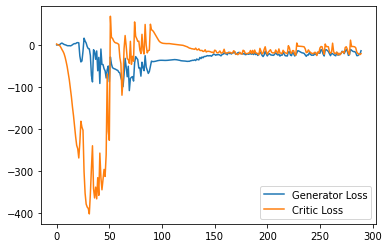

Step 5850: Generator loss: -21.29592710494995, critic loss: -17.409563715696333


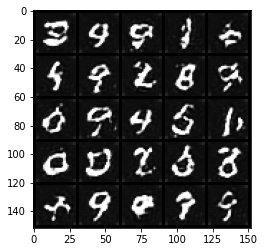

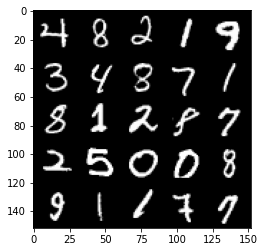

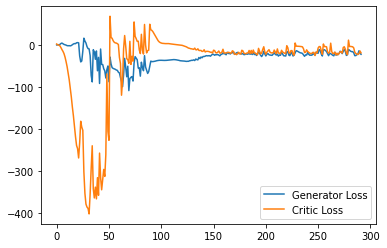

Step 5900: Generator loss: -18.21602433681488, critic loss: -12.932567317485809


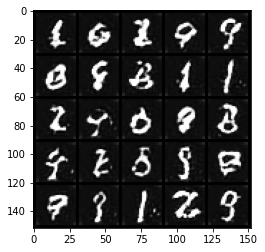

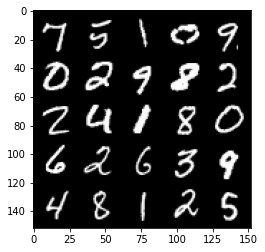

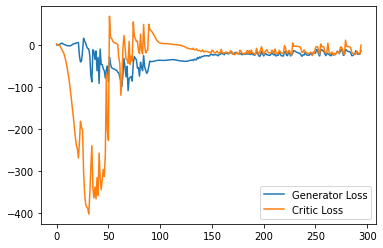

Step 5950: Generator loss: -9.717374801635742, critic loss: -3.5960089254379266


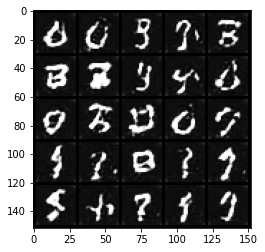

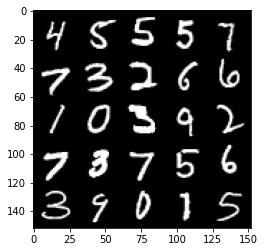

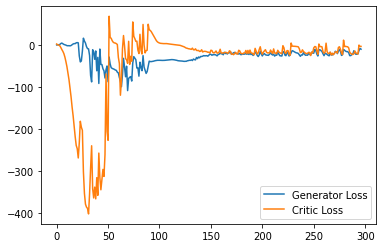

Step 6000: Generator loss: -13.304066677093505, critic loss: -3.542640068054199


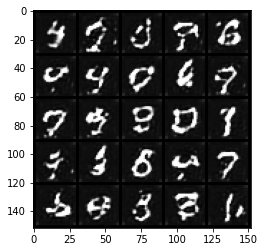

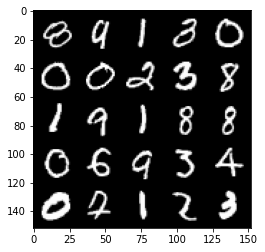

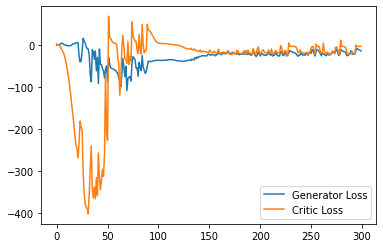

Step 6050: Generator loss: -14.889331130981445, critic loss: -3.6674990596771226


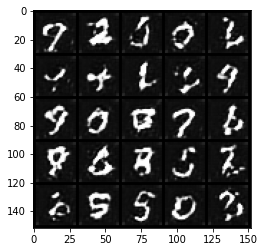

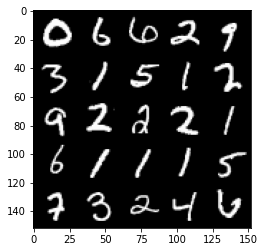

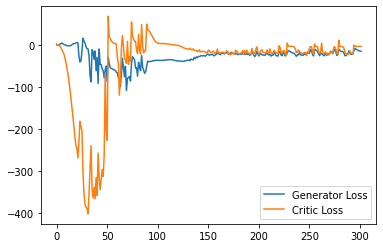

Step 6100: Generator loss: -16.180494747161866, critic loss: -4.295656383514404


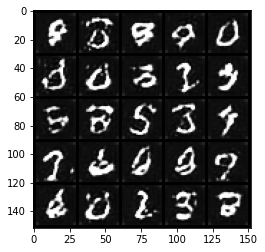

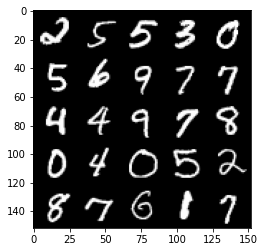

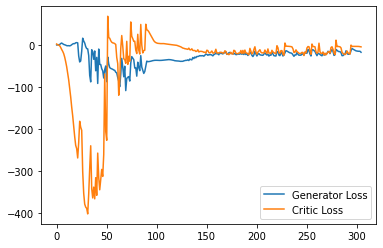

Step 6150: Generator loss: -22.84141300678253, critic loss: -19.51473796761036


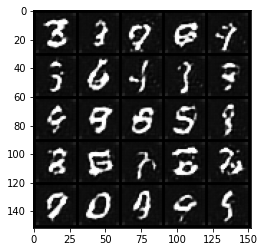

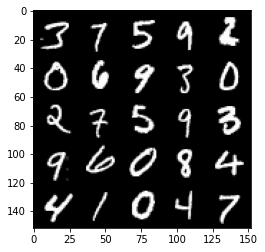

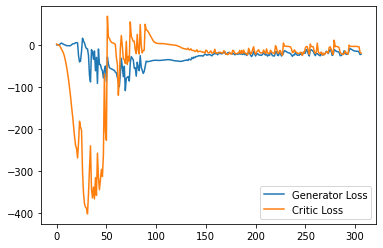

Step 6200: Generator loss: -19.792920331954956, critic loss: -23.282664429664607


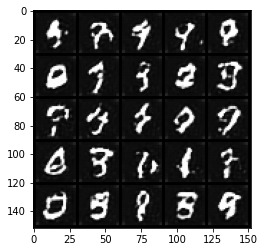

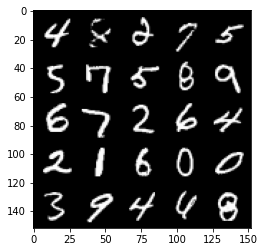

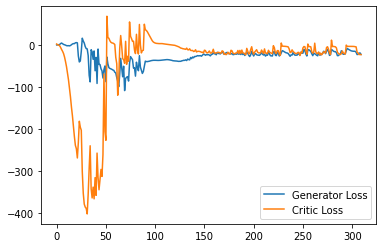

Step 6250: Generator loss: -15.263881640434265, critic loss: -5.741572554588317


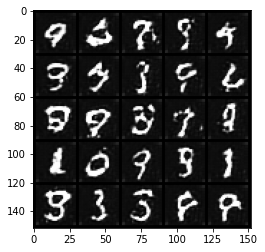

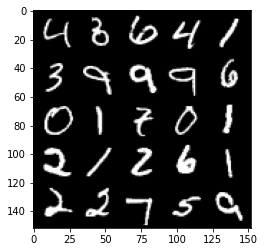

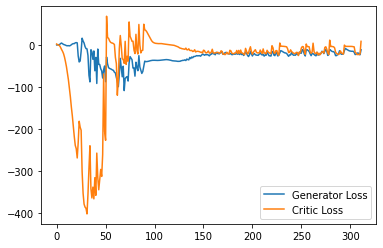

Step 6300: Generator loss: -12.285994091033935, critic loss: -3.7546731204986568


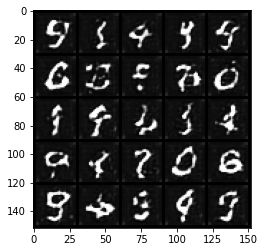

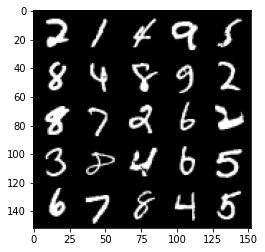

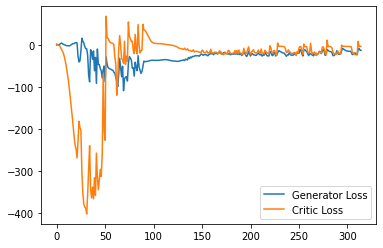

Step 6350: Generator loss: -12.510429439544678, critic loss: -4.346743821144104


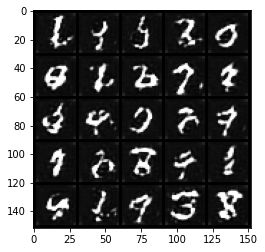

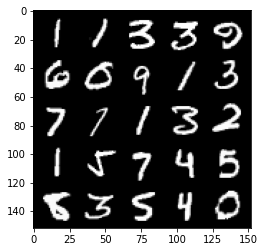

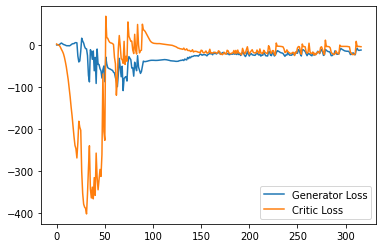

Step 6400: Generator loss: -19.261561013162137, critic loss: -14.003745791912076


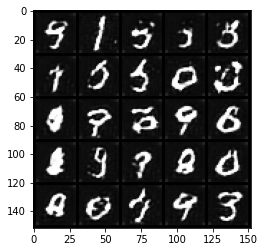

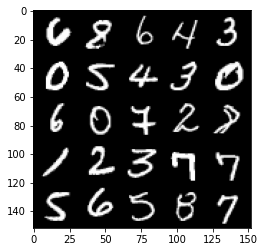

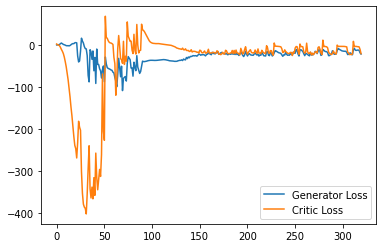

Step 6450: Generator loss: -19.095603772252797, critic loss: -19.61634626150131


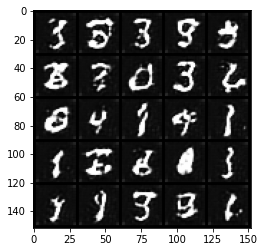

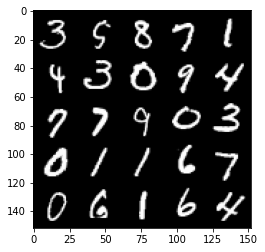

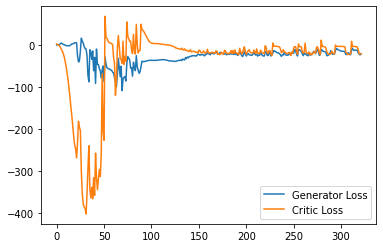

Step 6500: Generator loss: -17.64843627512455, critic loss: -16.87121641778946


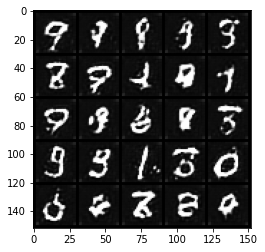

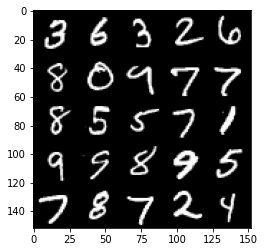

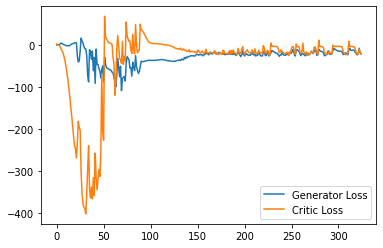

Step 6550: Generator loss: -11.894764442443847, critic loss: -4.7248123703002936


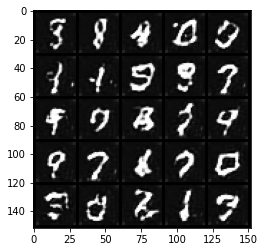

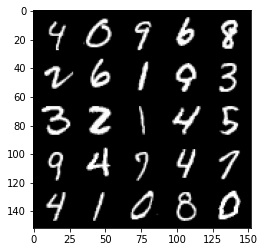

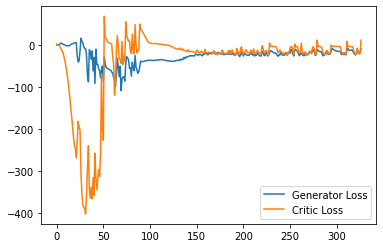

Step 6600: Generator loss: -8.816313514709472, critic loss: -3.5983297986984253


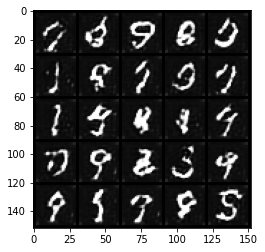

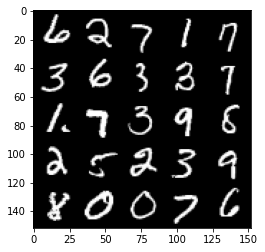

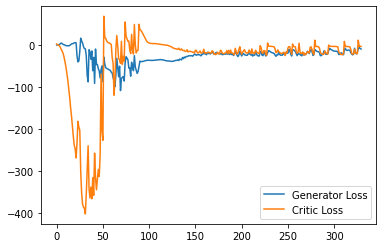

Step 6650: Generator loss: -10.084333267211914, critic loss: -4.231397877693178


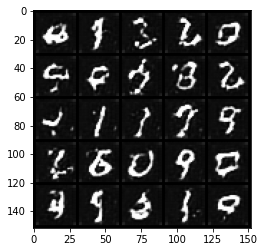

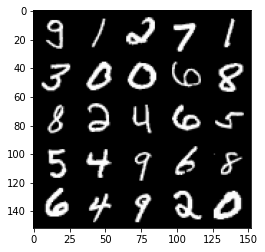

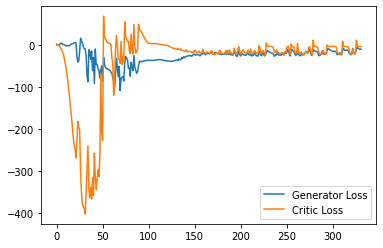

Step 6700: Generator loss: -14.298781642913818, critic loss: -10.403876982927322


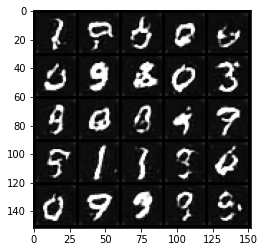

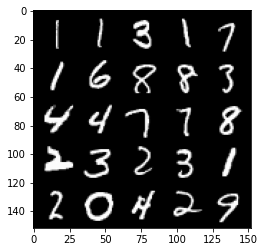

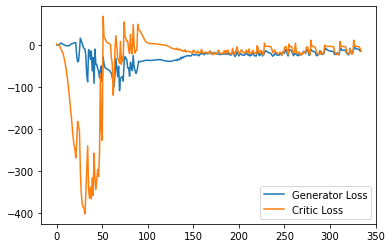

Step 6750: Generator loss: -19.67343970298767, critic loss: -21.988191447257996


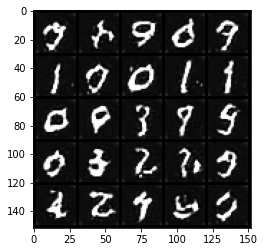

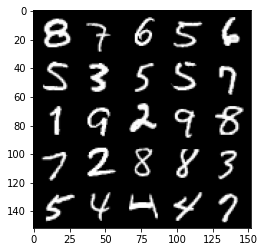

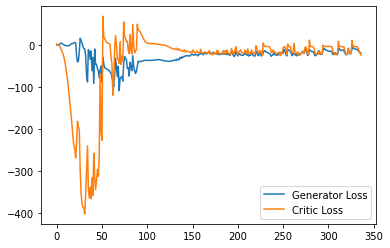

Step 6800: Generator loss: -14.454908703565598, critic loss: -17.93026728439331


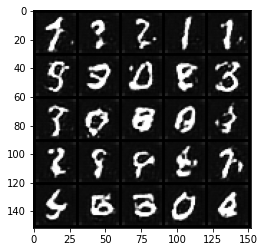

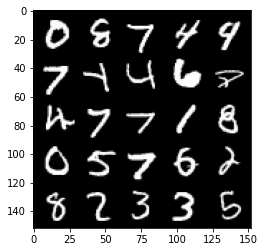

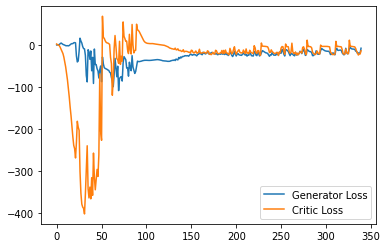

Step 6850: Generator loss: -8.644018231630325, critic loss: -14.4906208152771


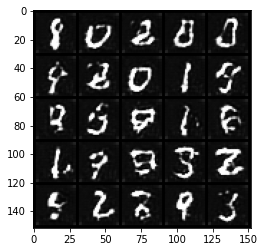

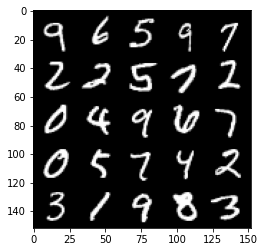

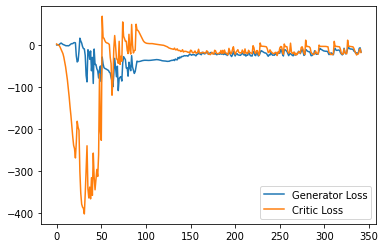

Step 6900: Generator loss: -11.724846424460411, critic loss: -16.4108068857193


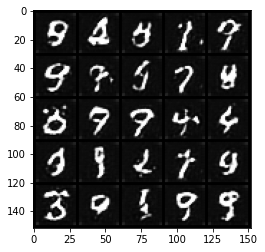

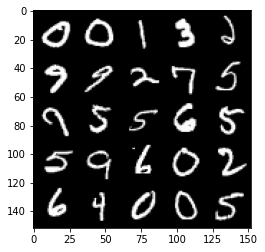

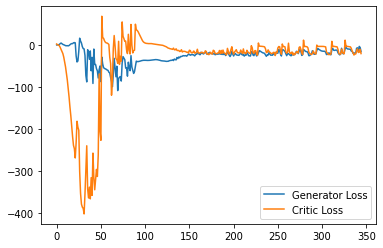

Step 6950: Generator loss: -8.336759073734283, critic loss: 0.9165054017305365


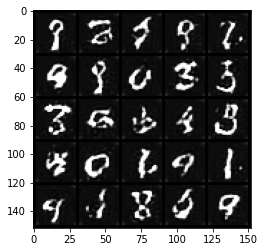

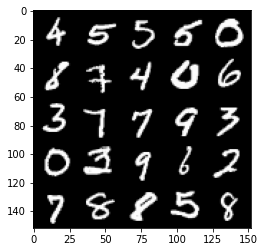

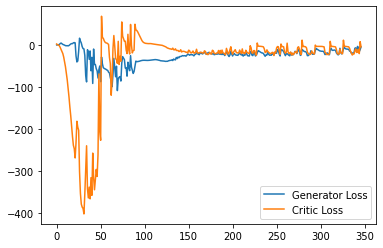

Step 7000: Generator loss: -13.392391586303711, critic loss: -8.813510819911956


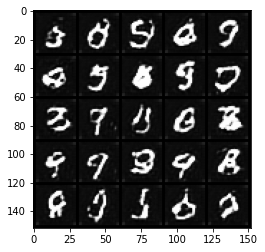

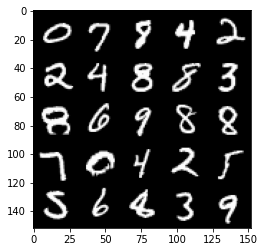

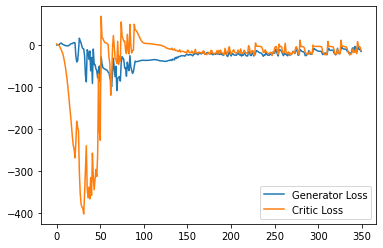

Step 7050: Generator loss: -15.12117130279541, critic loss: -18.717747752189634


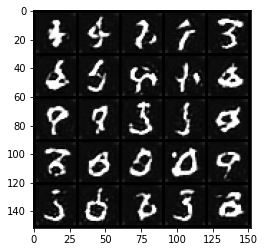

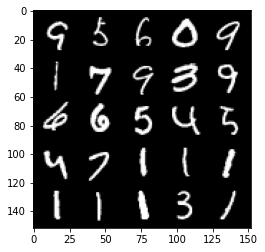

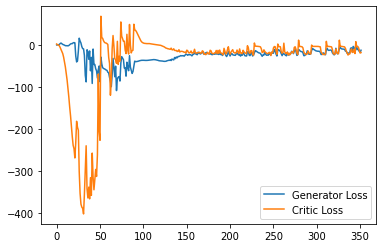

Step 7100: Generator loss: -14.867267103195191, critic loss: -19.38815320634842


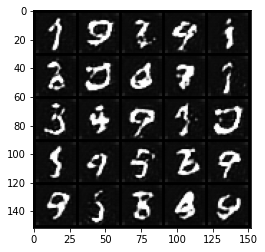

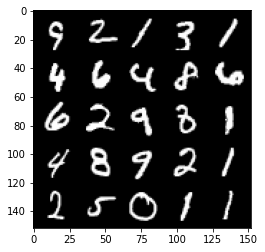

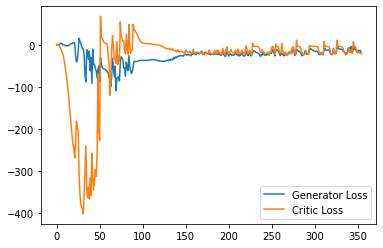

Step 7150: Generator loss: -6.969854805022478, critic loss: -7.59269131422043


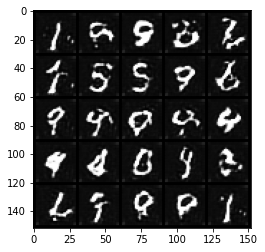

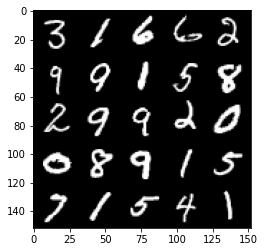

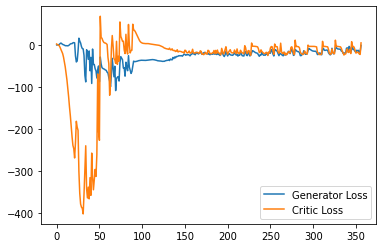

Step 7200: Generator loss: -7.899705891609192, critic loss: -10.388150947570802


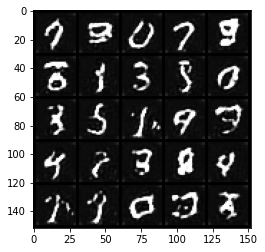

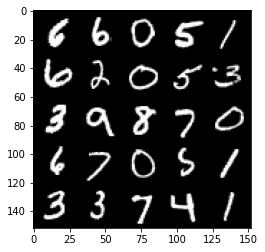

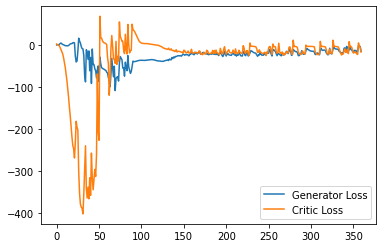

Step 7250: Generator loss: -10.062692148387432, critic loss: -15.143645379543305


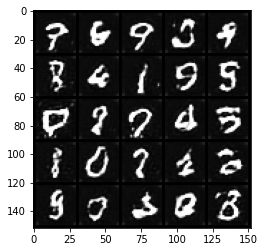

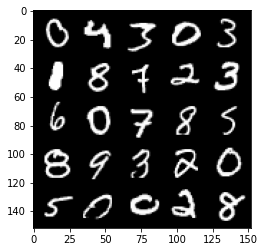

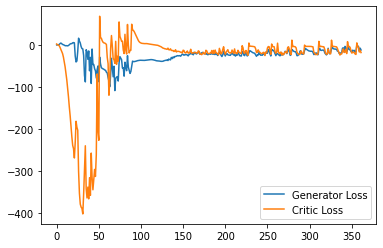

Step 7300: Generator loss: -11.387105981111526, critic loss: -16.67106778144836


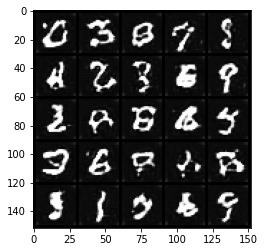

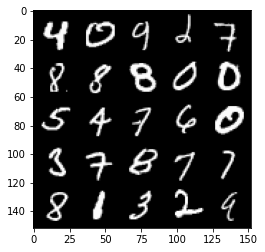

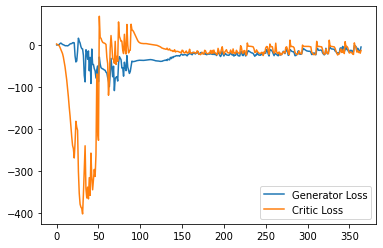

Step 7350: Generator loss: -10.637538627386093, critic loss: -12.890090163230893


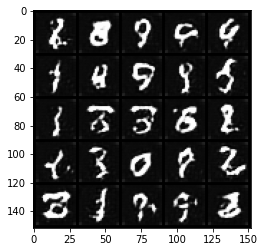

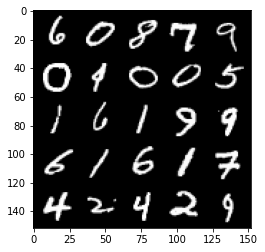

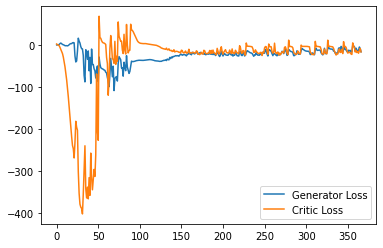

Step 7400: Generator loss: -17.253688848018648, critic loss: -20.27230562925339


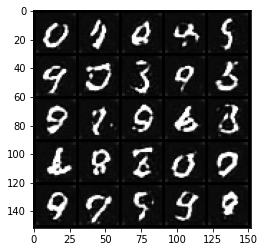

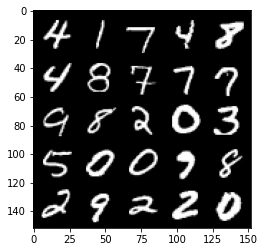

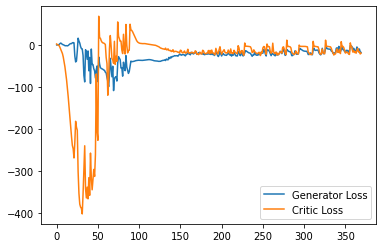

Step 7450: Generator loss: -11.648239232301712, critic loss: -9.673438346385948


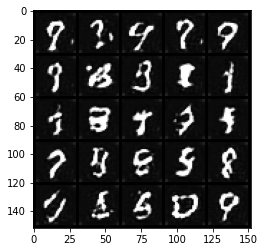

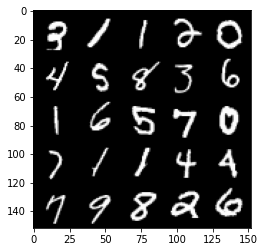

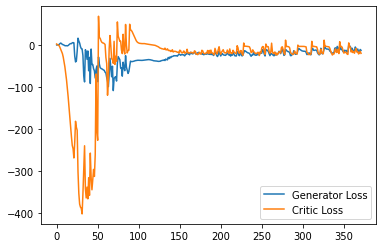

Step 7500: Generator loss: -10.865713157653808, critic loss: -7.1571660585403425


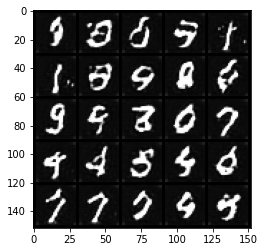

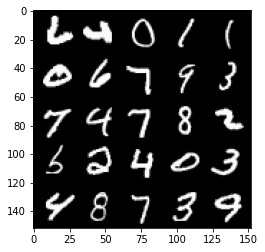

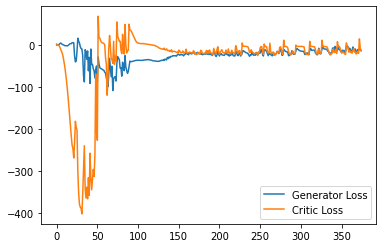

Step 7550: Generator loss: -5.564815678596497, critic loss: -10.150920977592465


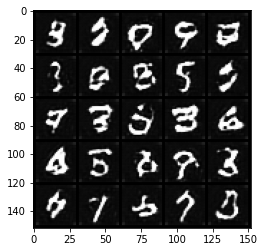

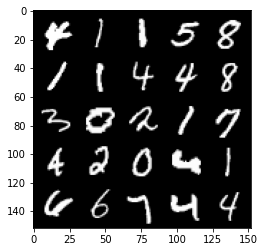

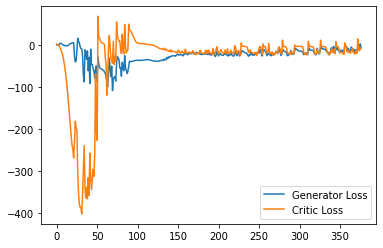

Step 7600: Generator loss: -12.380742518901824, critic loss: -18.928640498638153


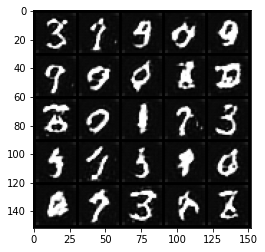

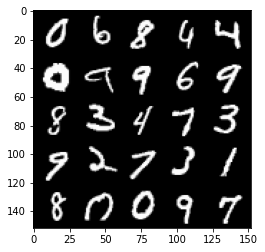

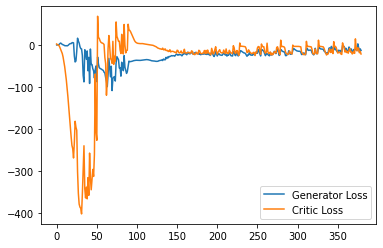

Step 7650: Generator loss: -6.253313893079758, critic loss: -13.345334305882453


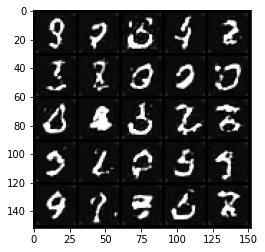

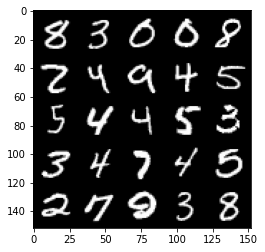

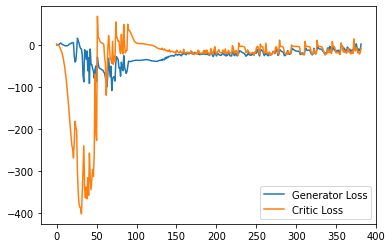

Step 7700: Generator loss: -7.7100191497802735, critic loss: -12.741843135833744


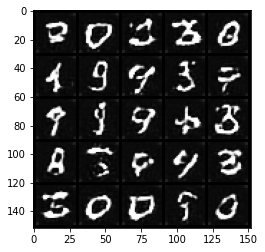

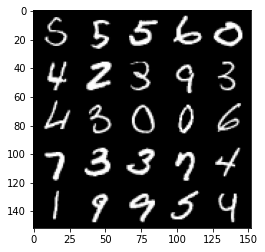

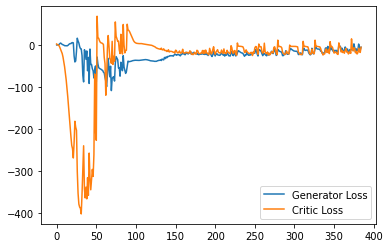

Step 7750: Generator loss: -9.012393035888671, critic loss: -16.842973577499393


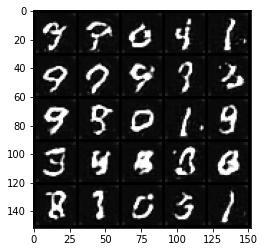

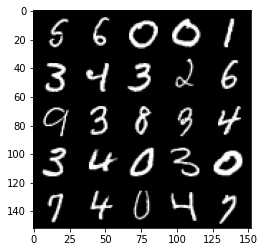

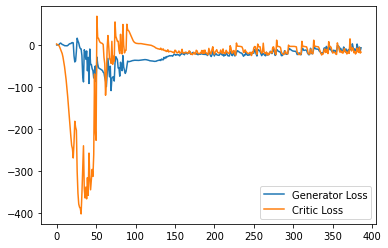

Step 7800: Generator loss: -14.572301542758941, critic loss: -22.02567442345618


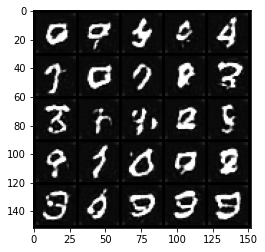

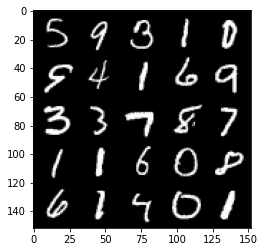

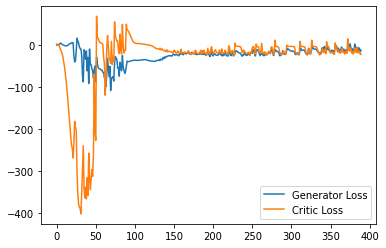

Step 7850: Generator loss: -10.582135982513428, critic loss: -23.436365171432488


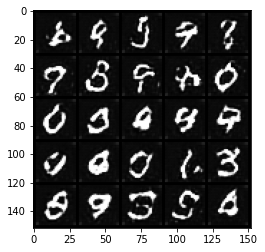

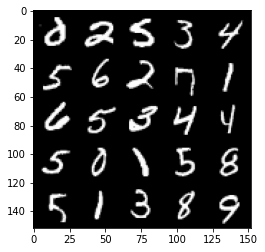

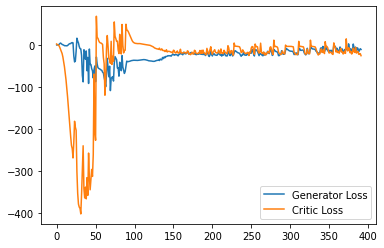

Step 7900: Generator loss: -9.020652080774306, critic loss: -15.386949151039127


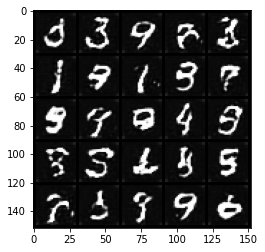

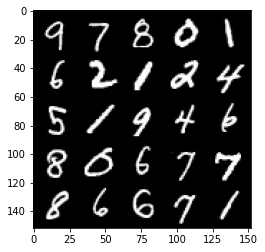

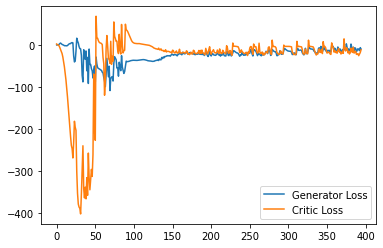

Step 7950: Generator loss: -3.6981719525158407, critic loss: -12.651019226789474


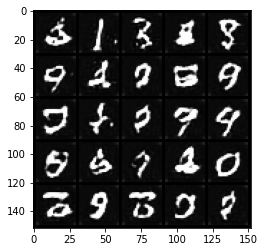

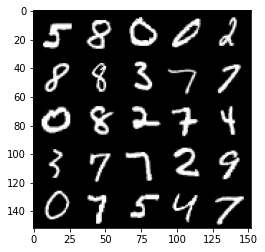

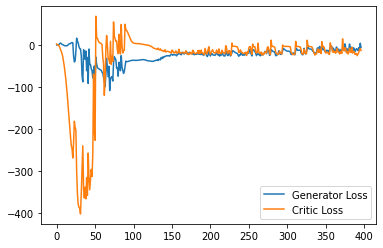

Step 8000: Generator loss: -10.35983282327652, critic loss: -18.846727862834932


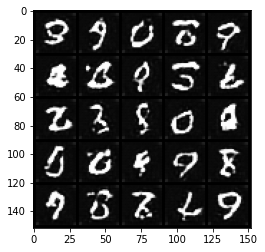

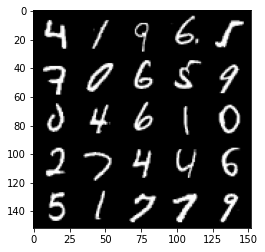

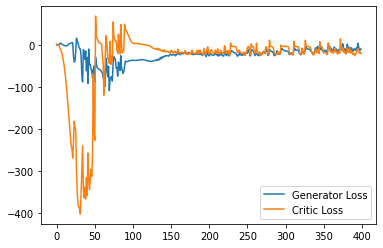

Step 8050: Generator loss: -6.00182483881712, critic loss: -9.85321459698677


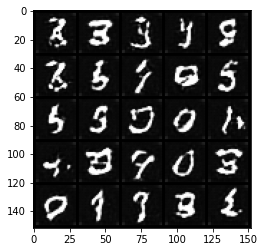

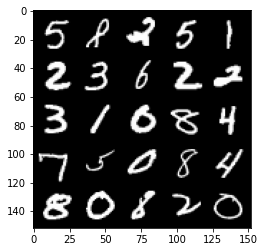

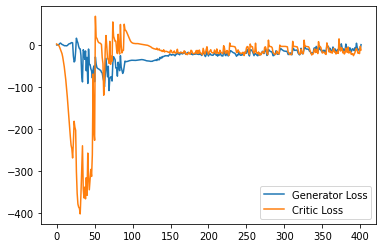

Step 8100: Generator loss: -4.667101843953133, critic loss: -16.199723101615902


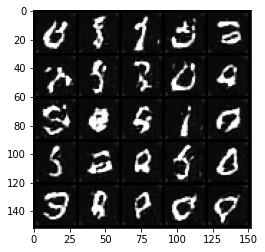

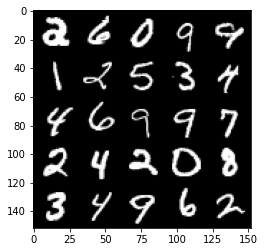

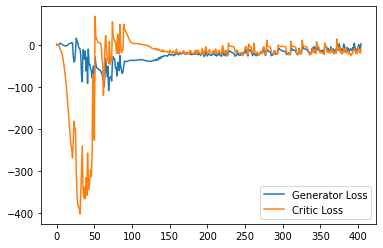

Step 8150: Generator loss: -6.67540281534195, critic loss: -16.863406925678255


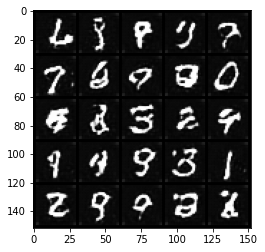

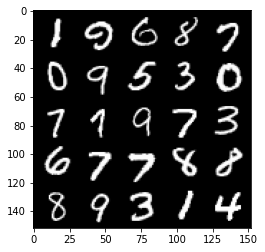

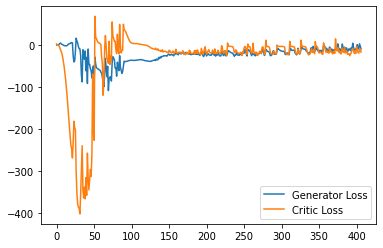

Step 8200: Generator loss: -3.3994214594364167, critic loss: -12.752382332324977


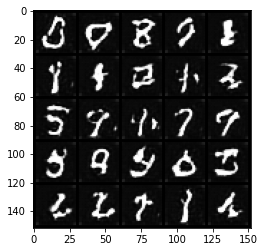

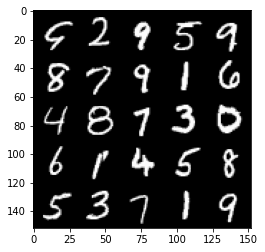

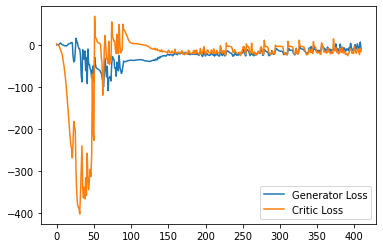

Step 8250: Generator loss: -9.448205300569533, critic loss: -21.393197755336764


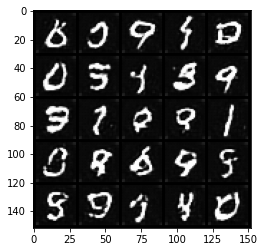

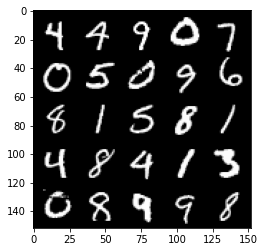

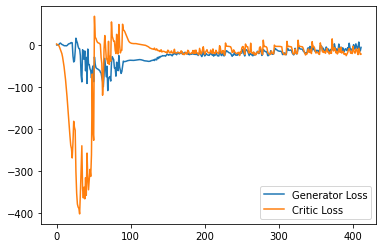

Step 8300: Generator loss: -7.2712609004974365, critic loss: -20.450204756021506


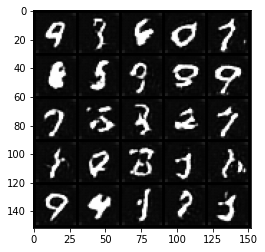

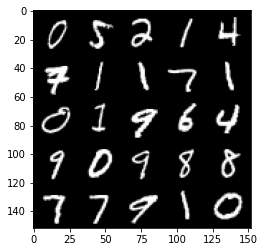

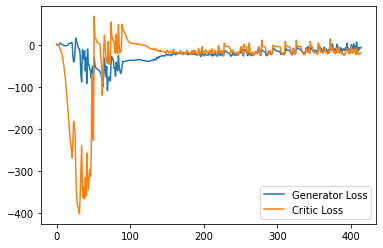

Step 8350: Generator loss: 2.4045419806241988, critic loss: 1.127681161403658


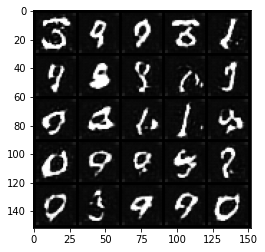

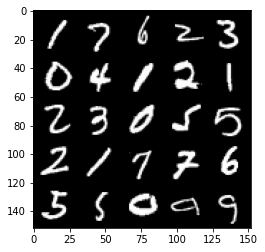

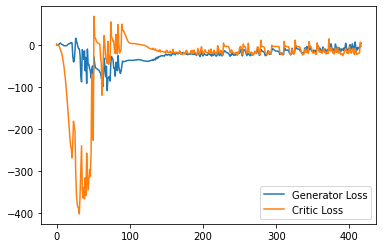

Step 8400: Generator loss: 1.9537855756282807, critic loss: -3.8529124870300304


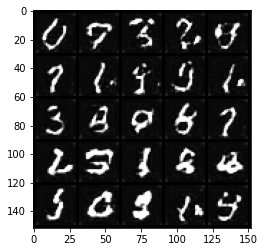

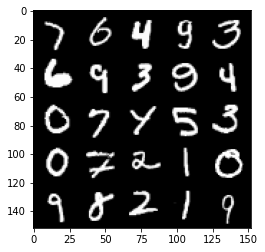

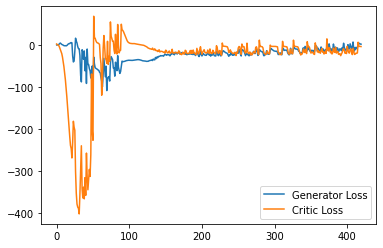

Step 8450: Generator loss: 0.7929547201097011, critic loss: -4.537662209510803


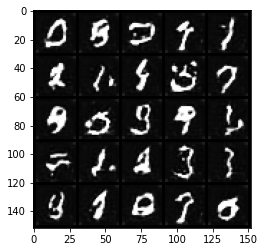

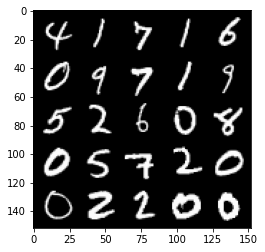

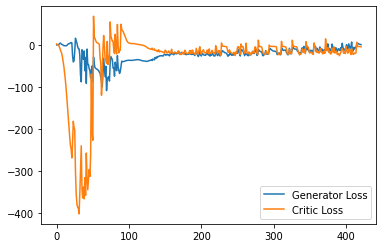

Step 8500: Generator loss: -7.062194854766131, critic loss: -17.427982253551484


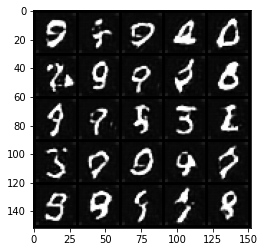

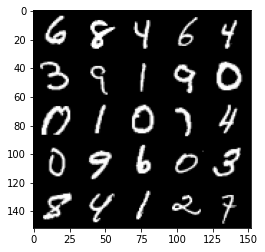

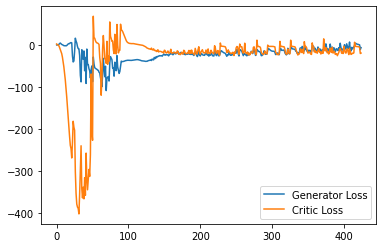

Step 8550: Generator loss: -1.915940625667572, critic loss: -16.48503337812424


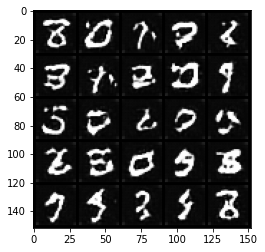

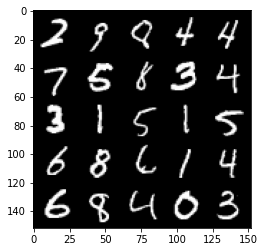

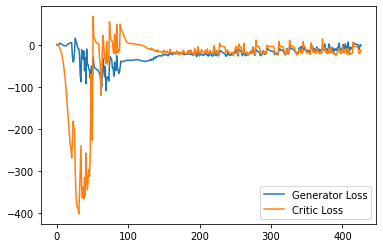

Step 8600: Generator loss: -5.069373306035995, critic loss: -16.12242030596733


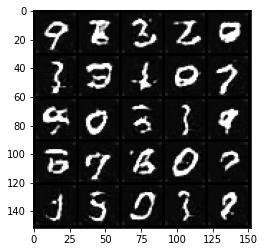

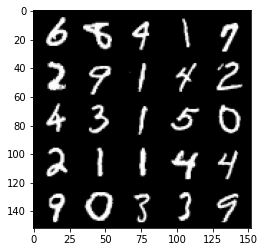

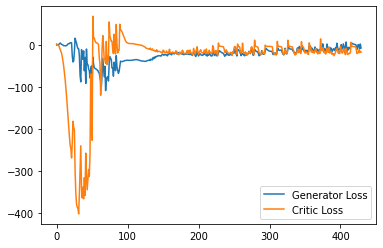

Step 8650: Generator loss: -3.2013599520921705, critic loss: -17.35917862021923


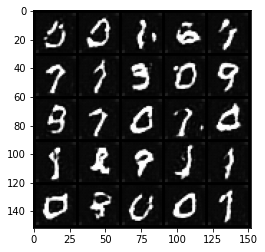

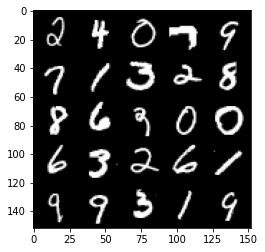

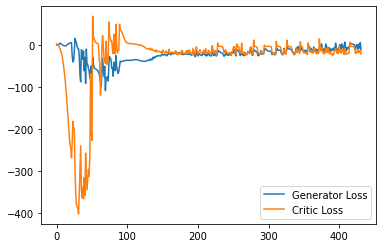

Step 8700: Generator loss: -5.257924721240998, critic loss: -17.98052092123032


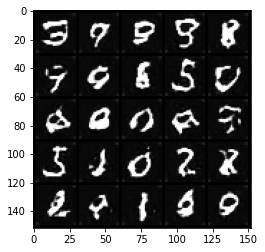

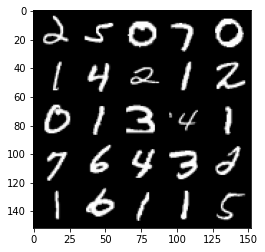

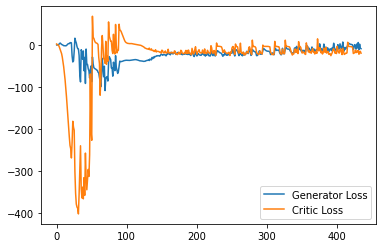

Step 8750: Generator loss: 2.917619067430496, critic loss: -3.754959134101868


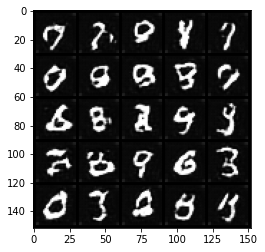

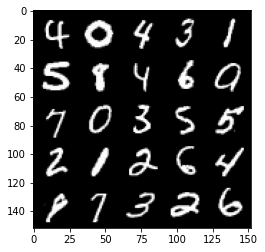

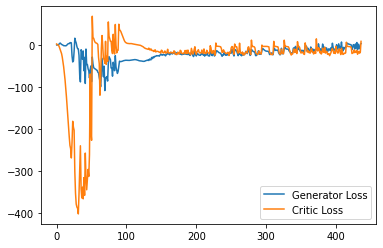

Step 8800: Generator loss: 4.38104434967041, critic loss: -3.8688706226348875


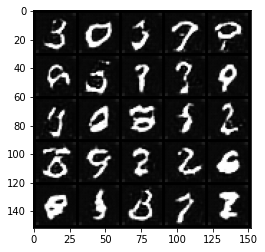

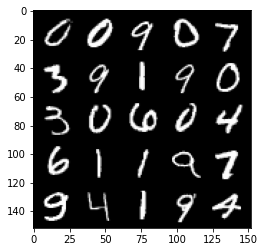

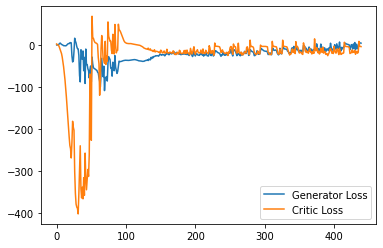

Step 8850: Generator loss: -3.9903594881296156, critic loss: -11.671871868133543


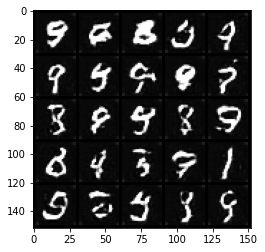

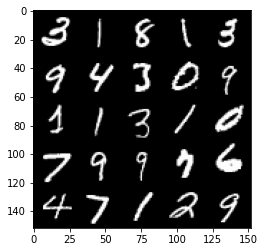

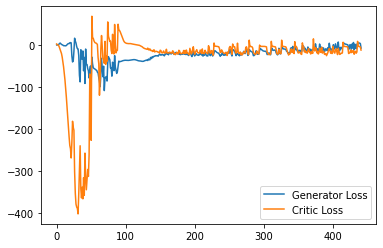

Step 8900: Generator loss: -3.886816186904907, critic loss: -16.598028851032257


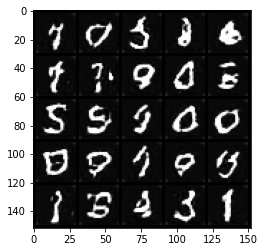

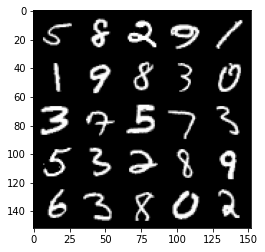

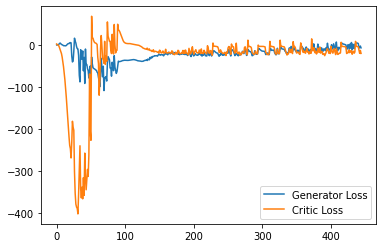

Step 8950: Generator loss: 3.0057785895466806, critic loss: -10.27855198287964


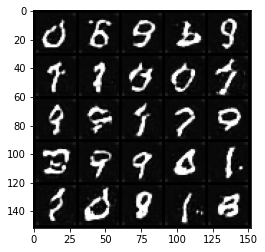

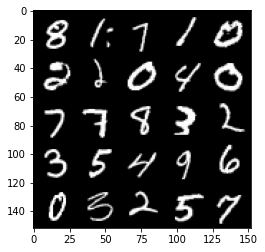

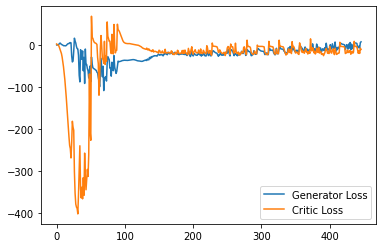

Step 9000: Generator loss: -1.9336897990107536, critic loss: -15.25049635112286


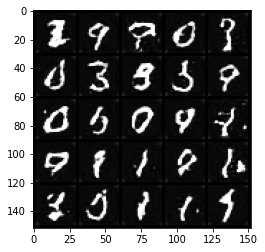

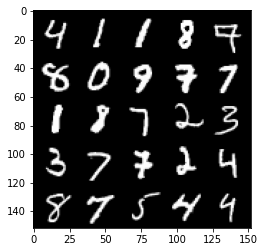

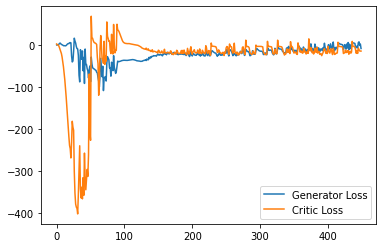

Step 9050: Generator loss: 1.1906666111946107, critic loss: -13.30296479010582


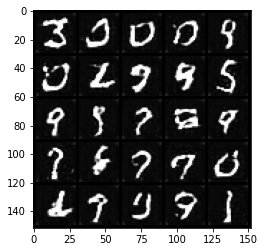

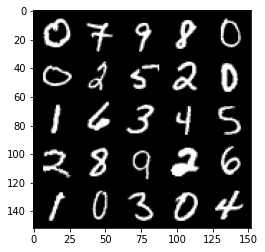

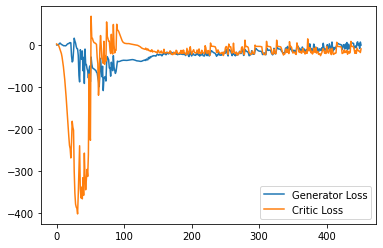

Step 9100: Generator loss: -3.6228534024953842, critic loss: -13.810461011409762


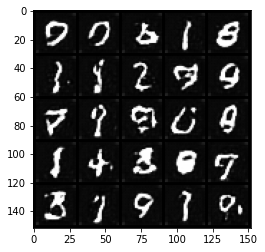

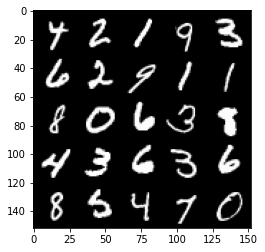

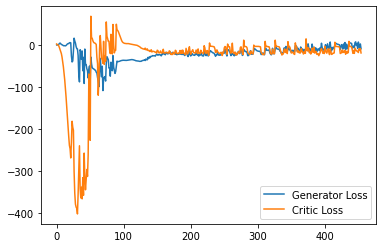

Step 9150: Generator loss: -0.6731194356083869, critic loss: -6.968160049080847


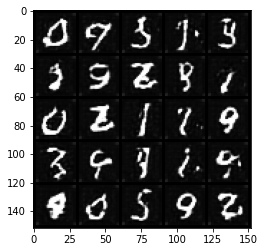

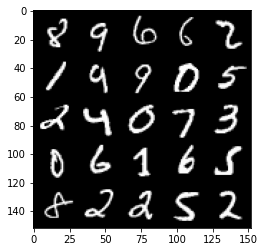

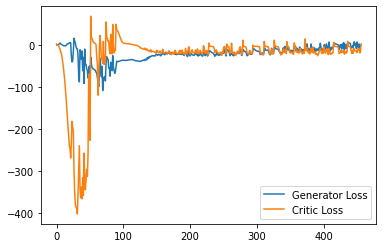

Step 9200: Generator loss: 0.9971344542503356, critic loss: -13.66639797115326


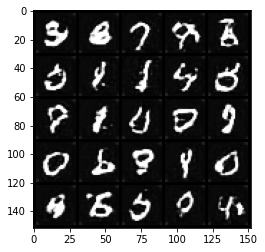

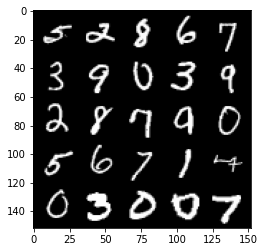

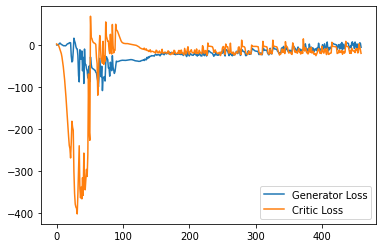

Step 9250: Generator loss: -0.02888142168521881, critic loss: -16.056911890983578


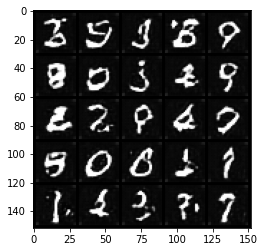

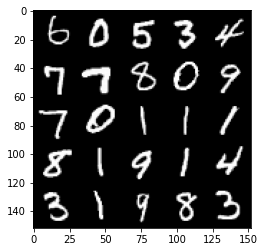

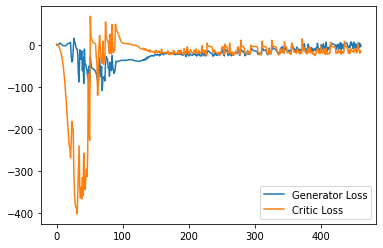

Step 9300: Generator loss: 1.476143150627613, critic loss: -16.457588428497317


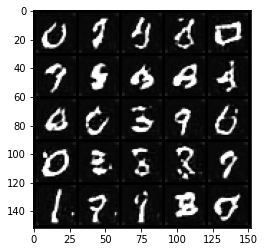

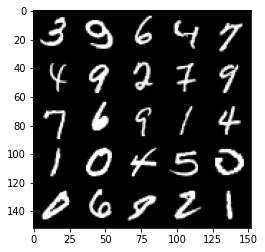

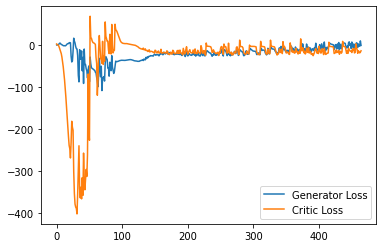

Step 9350: Generator loss: -2.5699662709236146, critic loss: -21.696527873516082


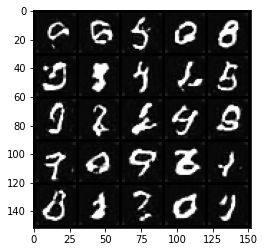

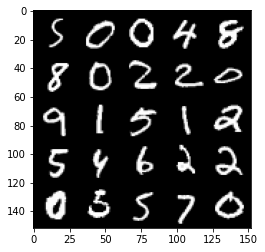

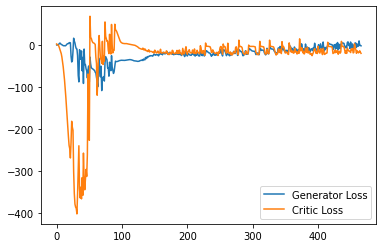

Step 9400: Generator loss: -0.2882223805785179, critic loss: -12.637001797199252


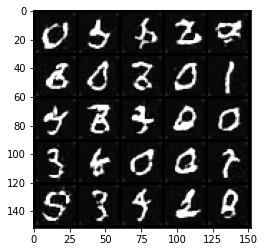

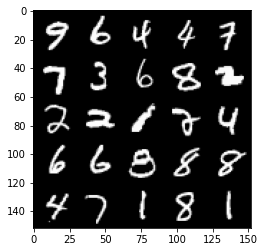

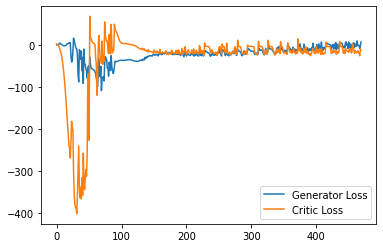

Step 9450: Generator loss: -4.608729583621025, critic loss: -22.145658399105077


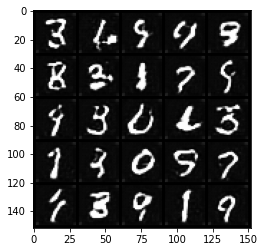

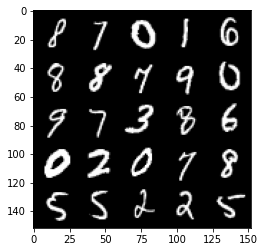

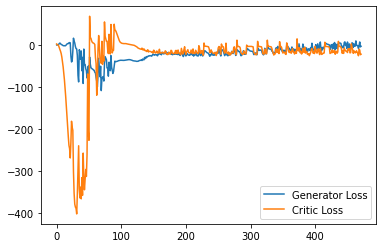

Step 9500: Generator loss: 3.557962223291397, critic loss: -13.197026690483094


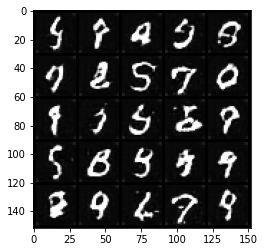

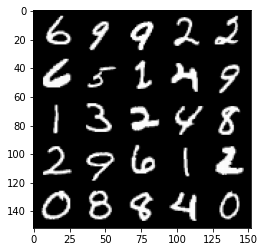

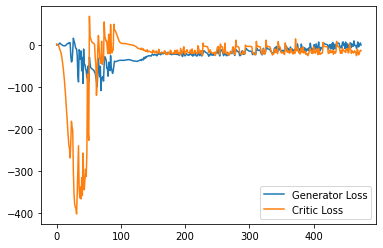

Step 9550: Generator loss: -2.650166155099869, critic loss: -17.755414764881134


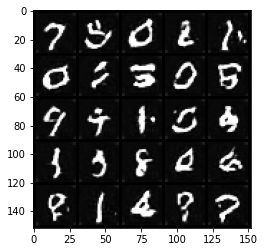

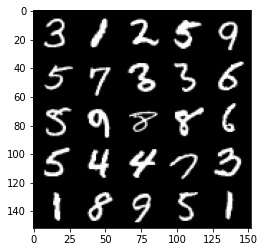

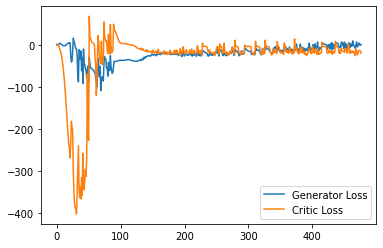

Step 9600: Generator loss: 4.363204431831837, critic loss: -4.794478665828707


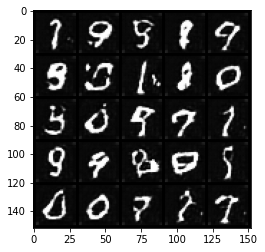

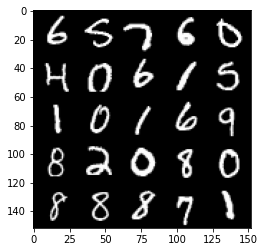

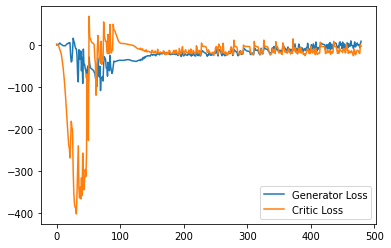

Step 9650: Generator loss: 3.943884399533272, critic loss: -7.355177724838259


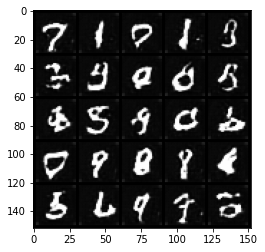

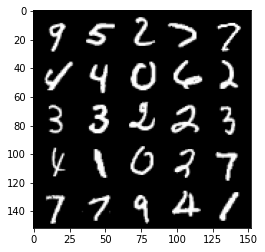

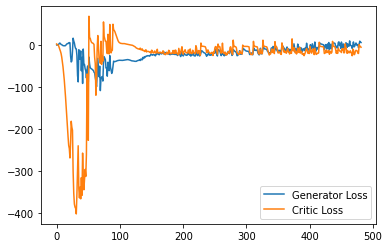

Step 9700: Generator loss: 3.8036493110656737, critic loss: -14.201199076652523


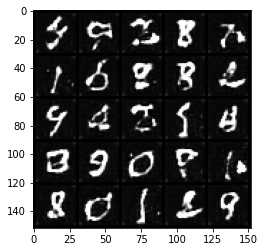

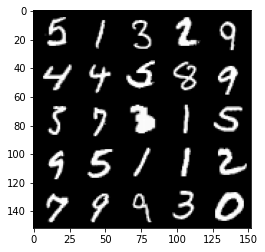

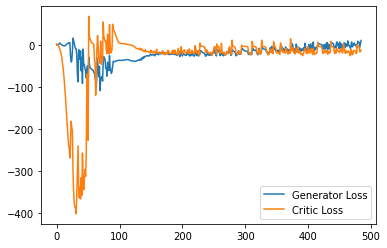

Step 9750: Generator loss: -4.398770855665207, critic loss: -9.972986431598665


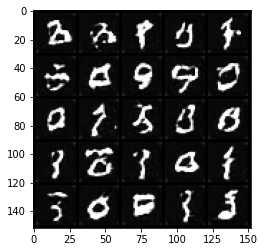

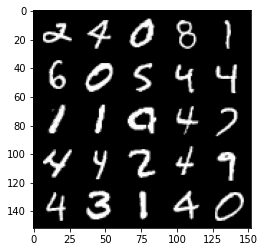

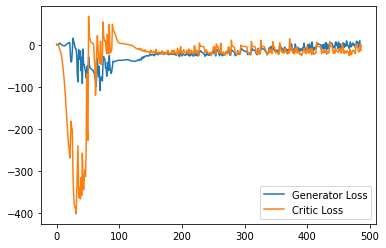

Step 9800: Generator loss: 0.14949718594551087, critic loss: -16.610443846225746


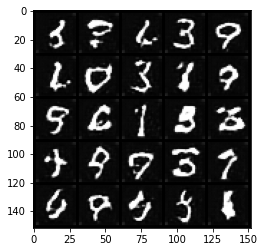

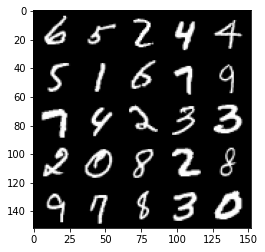

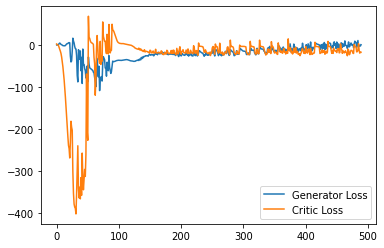

Step 9850: Generator loss: -0.13380979299545287, critic loss: -15.873285046339033


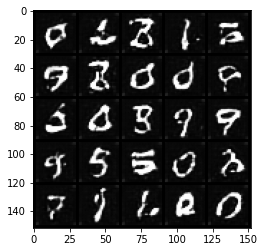

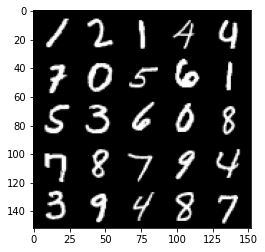

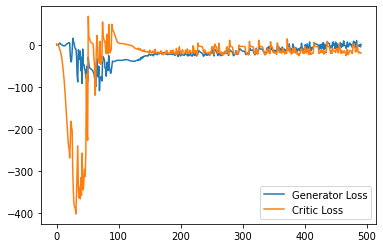

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
